# Notebook 2: Clustering

This notebook was created under the scope of the Business Cases for Data Science Curricular Unit at Nova IMS.

In particular, this notebook will be used 

In [1]:
#Import Librareies

import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.ticker import FormatStrFormatter
from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import association_rules


import seaborn as sns
import squarify


from sklearn.decomposition import PCA

#pandas profiling
from pandas_profiling import ProfileReport
#SKlearn preprocessing and model selection tools

from sklearn import preprocessing
from sklearn.preprocessing import MinMaxScaler, QuantileTransformer, StandardScaler

#SKlearn clustering tools
from sklearn.neighbors import LocalOutlierFactor
from sklearn.impute import KNNImputer
from sklearn.mixture import GaussianMixture
from sklearn.cluster import AgglomerativeClustering , KMeans, DBSCAN
from scipy.cluster.hierarchy import dendrogram
from sklearn.metrics import silhouette_score
from sklearn.manifold import TSNE


#other packages
import statistics
from math import ceil
from collections import Counter
from sklearn.metrics import calinski_harabasz_score

import warnings
warnings.filterwarnings('ignore')
sns.set()
#!pip install mlxtend
#!pip install networkx

### Import and merge data

In [2]:
departments = pd.read_csv('./CSV/departments.csv')
order_products = pd.read_csv('./CSV/order_products.csv')
orders = pd.read_csv('./CSV/orders.csv')
products = pd.read_csv('./CSV/products.csv')

In [3]:
complete_orders = pd.merge(departments,products, on='department_id')
complete_orders = pd.merge(complete_orders,order_products, on='product_id')
complete_orders = pd.merge(complete_orders,orders, on='order_id')
#complete_orders = complete_orders.drop(columns =['department_id','product_id']) #tirar user_id?


In [4]:
complete_orders[complete_orders['days_since_prior_order']==11]

,department_id,department,product_id,product_name,order_id,add_to_cart_order,reordered,user_id,order_number,order_dow,order_hour_of_day,days_since_prior_order
480,1,frozen,38,frozen meals,10478,1,1,68912,4,0,14,11.0
481,1,frozen,116,frozen produce,10478,19,0,68912,4,0,14,11.0
482,4,produce,123,packaged vegetables fruits,10478,14,0,68912,4,0,14,11.0
483,4,produce,83,fresh vegetables,10478,4,0,68912,4,0,14,11.0
484,4,produce,83,fresh vegetables,10478,10,0,68912,4,0,14,11.0
...,...,...,...,...,...,...,...,...,...,...,...,...
2019219,20,deli,14,tofu meat alternatives,2192369,1,1,24036,18,3,8,11.0
2019232,20,deli,14,tofu meat alternatives,3324675,1,0,135062,2,0,11,11.0
2019243,20,deli,96,lunch meat,244608,1,0,40741,9,2,13,11.0
2019279,20,deli,96,lunch meat,2202603,1,1,63937,4,1,13,11.0


### Initial Understanding

In [5]:
complete_orders.duplicated().sum()

0

In [6]:
complete_orders.isna().sum()

department_id                  0
department                     0
product_id                     0
product_name                   0
order_id                       0
add_to_cart_order              0
reordered                      0
user_id                        0
order_number                   0
order_dow                      0
order_hour_of_day              0
days_since_prior_order    124342
dtype: int64

In [7]:
complete_orders.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
department_id,2019501.0,NaN,NaN,NaN,9.928349,6.282933,1.0,4.0,9.0,16.0,21.0
department,2019501,21,produce,588996,NaN,NaN,NaN,NaN,NaN,NaN,NaN
product_id,2019501.0,NaN,NaN,NaN,71.205904,38.207275,1.0,31.0,83.0,107.0,134.0
product_name,2019501,134,fresh fruits,226039,NaN,NaN,NaN,NaN,NaN,NaN,NaN
order_id,2019501.0,NaN,NaN,NaN,1707012.762445,985983.196234,10.0,852649.0,1705004.0,2559031.0,3421080.0
add_to_cart_order,2019501.0,NaN,NaN,NaN,8.363173,7.150059,1.0,3.0,6.0,11.0,137.0
reordered,2019501.0,NaN,NaN,NaN,0.589743,0.49188,0.0,0.0,1.0,1.0,1.0
user_id,2019501.0,NaN,NaN,NaN,103067.265697,59491.165074,2.0,51584.0,102690.0,154600.0,206209.0
order_number,2019501.0,NaN,NaN,NaN,17.151377,17.525765,1.0,5.0,11.0,24.0,100.0
order_dow,2019501.0,NaN,NaN,NaN,2.735367,2.093882,0.0,1.0,3.0,5.0,6.0


### Some Data Exploration

## Looking for Customer Types

1. Define the characteristics of our population - get clusters: assuming they are discearnable, 
2. Get association rules of purchase if, and only if, the clusters are discearnible

In [8]:
complete_orders.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2019501 entries, 0 to 2019500
Data columns (total 12 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   department_id           int64  
 1   department              object 
 2   product_id              int64  
 3   product_name            object 
 4   order_id                int64  
 5   add_to_cart_order       int64  
 6   reordered               int64  
 7   user_id                 int64  
 8   order_number            int64  
 9   order_dow               int64  
 10  order_hour_of_day       int64  
 11  days_since_prior_order  float64
dtypes: float64(1), int64(9), object(2)
memory usage: 200.3+ MB


In [9]:
#hepful to remove multiindex

def flattenHierarchicalCol(col,sep = '_'):
    '''converts multiindex columns into single index columns while retaining the hierarchical components'''
    if not type(col) is tuple:
        return col
    else:
        new_col = ''
        for leveli,level in enumerate(col):
            if not level == '':
                if not leveli == 0:
                    new_col += sep
                new_col += level
        return new_col

In [10]:
# criteria fopr clustering experiment design
#to find types of customer, groups customers by 3 main perspectives: 
#a. number of purchases made and how long customer has been with us, 
#b. know how does he buy and when (time of day and day of week, how long are purchases
#c. product interactions (for a given customer, how disperse are the purchases (count) and what are the most common)


group_ord = complete_orders.groupby(['user_id']).agg({'order_id': ['min', 'median', 'max', 'count'], 
                                                      'order_hour_of_day': ['min', 'mean', 'median', 'max', lambda x: x.value_counts().index[0]],  
                                                      'days_since_prior_order': ['min', 'mean', 'median', 'max'],
                                                      'order_dow' :  ['min', 'median', 'max', lambda x: x.value_counts().index[0]],
                                                      'add_to_cart_order' : ['mean', 'median', 'max'], 

                                                     })
group_ord.columns = group_ord.columns.map(flattenHierarchicalCol)
group_ord.reset_index(inplace = True)
group_ord.set_index('user_id', inplace = True)
group_ord

,order_id_min,order_id_median,order_id_max,order_id_count,order_hour_of_day_min,order_hour_of_day_mean,order_hour_of_day_median,order_hour_of_day_max,order_hour_of_day_<lambda_0>,days_since_prior_order_min,days_since_prior_order_mean,days_since_prior_order_median,days_since_prior_order_max,order_dow_min,order_dow_median,order_dow_max,order_dow_<lambda_0>,add_to_cart_order_mean,add_to_cart_order_median,add_to_cart_order_max
user_id,,,,,,,,,,,,,,,,,,,,
2,1501582,1501582.0,1901567,11,10,10.000000,10.0,10,10,3.0,6.818182,10.0,10.0,1,5.0,5,5,3.272727,3.0,6
3,444309,521107.0,2037211,19,18,18.473684,18.0,19,18,9.0,12.421053,11.0,20.0,0,2.0,3,3,3.947368,4.0,9
7,121053,121053.0,121053,24,18,18.000000,18.0,18,18,30.0,30.000000,30.0,30.0,0,0.0,0,0,12.500000,12.5,24
10,83395,83395.0,83395,30,15,15.000000,15.0,15,15,14.0,14.000000,14.0,14.0,3,3.0,3,3,15.500000,15.5,30
11,2921164,2921164.0,2921164,11,11,11.000000,11.0,11,11,30.0,30.000000,30.0,30.0,5,5.0,5,5,6.000000,6.0,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
206204,2511735,2511735.0,2511735,20,8,8.000000,8.0,8,8,11.0,11.000000,11.0,11.0,5,5.0,5,5,10.500000,10.5,20
206205,414137,414137.0,414137,7,16,16.000000,16.0,16,16,10.0,10.000000,10.0,10.0,5,5.0,5,5,4.000000,4.0,7
206206,381242,648225.0,2147399,15,16,17.933333,18.0,19,18,0.0,2.666667,4.0,4.0,0,3.0,4,0,3.133333,3.0,7


## To create PCA from product purchases

To determine the product preferences, we will.
1. Create Pivot Table with all purchases spread around the week.
2. Apply PCA to reduce dimensionality
3. Use PCA Components as variables to determine purchase habits

In [11]:
complete_orders['order_dow'] = complete_orders['order_dow'].astype(str)

In [12]:
complete_orders['order_dow'] = complete_orders['order_dow'].str.replace('0', 'Sunday')
complete_orders['order_dow'] = complete_orders['order_dow'].str.replace('1', 'Monday')
complete_orders['order_dow'] = complete_orders['order_dow'].str.replace('2', 'Tuesday')
complete_orders['order_dow'] = complete_orders['order_dow'].str.replace('3', 'Wednesday')
complete_orders['order_dow'] = complete_orders['order_dow'].str.replace('4', 'Thursday')
complete_orders['order_dow'] = complete_orders['order_dow'].str.replace('5', 'Friday')
complete_orders['order_dow'] = complete_orders['order_dow'].str.replace('6', 'Saturday')

In [13]:
pivot = pd.pivot_table(complete_orders, index= 'user_id', 
                        #columns= ['order_dow', 'product_name'], values = 'product_id', aggfunc='count', fill_value = 0)
                        columns= ['order_dow', 'department'], values = 'department_id', aggfunc='count', fill_value = 0)
pivot

order_dow   Friday                                                      \
department alcohol babies bakery beverages breakfast bulk canned goods   
user_id                                                                  
2                0      0      0         0         0    0            0   
3                0      0      0         0         0    0            0   
7                0      0      0         0         0    0            0   
10               0      0      0         0         0    0            0   
11               0      0      0         3         0    0            0   
...            ...    ...    ...       ...       ...  ...          ...   
206204           0      0      1         0         0    0            0   
206205           0      0      1         1         0    0            0   
206206           0      0      0         0         0    0            0   
206208           0      0      0         0         0    0            0   
206209           0      0      1         1         1    0            0   

order_dow                                   ... Wednesday                \
department dairy eggs deli dry goods pasta  ... household international   
user_id                                     ...                           
2                   1    1               0  ...         0             0   
3                   0    0               0  ...         1             0   
7                   0    0               0  ...         0             0   
10                  0    0               0  ...         0             0   
11                  2    0               0  ...         0             0   
...               ...  ...             ...  ...       ...           ...   
206204              6    0               2  ...         0             0   
206205              2    0               0  ...         0             0   
206206              0    0               0  ...         0             0   
206208              0    0               0  ...         0             0   
206209              1    0               0  ...         3             0   

order_dow                                                                       
department meat seafood missing other pantry personal care pets produce snacks  
user_id                                                                         
2                     0       0     0      0             0    0       0      0  
3                     0       0     0      0             0    0       2      2  
7                     0       0     0      0             0    0       0      0  
10                    4       0     0      4             0    0      13      0  
11                    0       0     0      0             0    0       0      0  
...                 ...     ...   ...    ...           ...  ...     ...    ...  
206204                0       0     0      0             0    0       0      0  
206205                0       0     0      0             0    0       0      0  
206206                0       0     0      0             0    0       0      0  
206208                0       0     0      0             0    0       0      0  
206209                0       0     0      0             0    0       2      1  

[105273 rows x 147 columns]

In [14]:
pivot.columns = pivot.columns.map(flattenHierarchicalCol)
pivot.reset_index(inplace = True)
pivot.set_index('user_id', inplace = True)
pivot

,Friday_alcohol,Friday_babies,Friday_bakery,Friday_beverages,Friday_breakfast,Friday_bulk,Friday_canned goods,Friday_dairy eggs,Friday_deli,Friday_dry goods pasta,...,Wednesday_household,Wednesday_international,Wednesday_meat seafood,Wednesday_missing,Wednesday_other,Wednesday_pantry,Wednesday_personal care,Wednesday_pets,Wednesday_produce,Wednesday_snacks
user_id,,,,,,,,,,,,,,,,,,,,,
2,0,0,0,0,0,0,0,1,1,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,2,2
7,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
10,0,0,0,0,0,0,0,0,0,0,...,0,0,4,0,0,4,0,0,13,0
11,0,0,0,3,0,0,0,2,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
206204,0,0,1,0,0,0,0,6,0,2,...,0,0,0,0,0,0,0,0,0,0
206205,0,0,1,1,0,0,0,2,0,0,...,0,0,0,0,0,0,0,0,0,0
206206,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


#### 2. Apply PCA

In [15]:
scaler = QuantileTransformer(output_distribution='normal')
#scaler = MinMaxScaler()
#scaler = StandardScaler()

pivot_s = pd.DataFrame(scaler.fit_transform(pivot), columns=pivot.columns, index=pivot.index)
pivot_s

,Friday_alcohol,Friday_babies,Friday_bakery,Friday_beverages,Friday_breakfast,Friday_bulk,Friday_canned goods,Friday_dairy eggs,Friday_deli,Friday_dry goods pasta,...,Wednesday_household,Wednesday_international,Wednesday_meat seafood,Wednesday_missing,Wednesday_other,Wednesday_pantry,Wednesday_personal care,Wednesday_pets,Wednesday_produce,Wednesday_snacks
user_id,,,,,,,,,,,,,,,,,,,,,
2,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,1.169401,1.811457,-5.199338,...,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338
3,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,...,2.004234,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,1.261282,1.767903
7,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,...,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338
10,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,...,-5.199338,-5.199338,3.129381,-5.199338,-5.199338,2.611712,-5.199338,-5.199338,2.651732,-5.199338
11,-5.199338,-5.199338,-5.199338,2.053336,-5.199338,-5.199338,-5.199338,1.418119,-5.199338,-5.199338,...,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
206204,-5.199338,-5.199338,1.733071,-5.199338,-5.199338,-5.199338,-5.199338,2.225823,-5.199338,2.365248,...,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338
206205,-5.199338,-5.199338,1.733071,1.407905,-5.199338,-5.199338,-5.199338,1.418119,-5.199338,-5.199338,...,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338
206206,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,...,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338


In [16]:
#reduce to number of components 55% variability

pca = PCA(n_components = 0.55, svd_solver = 'full')

df_pca = pd.DataFrame(pca.fit_transform(pivot_s), index=pivot_s.index)
df_pca.columns = df_pca.columns.astype(str)
df_pca = df_pca.add_prefix('PC_')
df_pca

,PC_0,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,PC_11,PC_12,PC_13,PC_14,PC_15,PC_16,PC_17
user_id,,,,,,,,,,,,,,,,,,
2,-4.672811,4.617433,2.474481,7.025814,-2.526465,-3.786512,-1.660472,-0.958678,-3.036578,-4.913082,-1.767363,0.668540,-1.061309,-3.175756,-1.229500,-0.593212,-2.599469,3.787483
3,0.900306,0.232421,-6.539411,-3.239857,6.732296,4.361127,-6.316375,-0.044015,-2.684496,-0.565271,0.438168,-0.374074,-3.439354,-1.142481,-2.817070,-0.481032,-0.666654,-5.772819
7,15.431280,2.915303,-3.627400,-0.027954,-1.473887,-0.880193,-0.234567,0.811535,0.250998,-1.327553,-2.584832,0.629483,-0.013085,3.500761,-1.524857,2.660677,1.143699,1.245050
10,-2.856548,-2.160762,-3.796528,-1.649168,-1.519149,7.332107,-6.720293,-2.328663,-0.463270,0.347851,-0.442197,-0.624564,1.952052,-0.300359,-0.556555,1.274900,0.930531,1.995829
11,-2.672930,-3.512852,-1.480707,7.299005,-2.476828,-4.342035,-1.697994,0.099282,-1.071446,1.180238,0.431382,0.546314,-0.081740,0.074166,0.792273,0.870880,-0.099576,-0.420584
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
206204,-2.757802,-3.741729,-1.288651,9.458605,-1.924249,-4.813606,-2.001671,-2.176119,0.835006,0.109256,-0.765271,-1.559398,1.556893,1.314065,0.342952,-2.753760,1.655527,1.326479
206205,-2.588974,-3.406647,-1.492863,6.650500,-2.572106,-4.164665,-1.587836,0.037674,-1.178650,0.268106,-0.244845,1.125093,0.397140,1.089037,0.910629,0.085207,-1.114978,-0.698284
206206,6.662565,0.328289,-3.596348,0.026761,-1.568055,2.669623,3.132219,1.182495,0.777179,1.204274,-4.397268,-3.870159,-2.192328,1.186770,-3.336381,-1.820466,0.307732,-1.495534


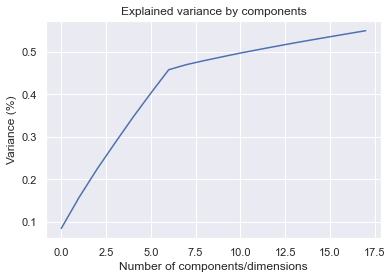

In [17]:
# Plot the cumulative explained variance
plt.figure()
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of components/dimensions')
plt.ylabel('Variance (%)')
plt.title('Explained variance by components')
plt.show()

([<matplotlib.axis.XTick at 0x18d402cb250>,
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

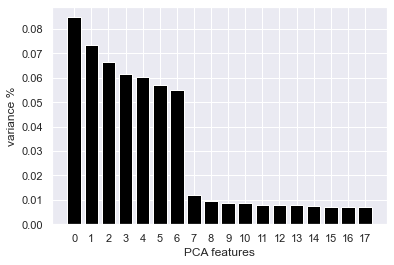

In [18]:
# Plot the explained variances
features = range(pca.n_components_)
plt.bar(features, pca.explained_variance_ratio_, color='black')
plt.xlabel('PCA features')
plt.ylabel('variance %')
plt.xticks(features)

In [19]:
#reduce to number to 6

pca = PCA(n_components = 6)

df_pca = pd.DataFrame(pca.fit_transform(pivot_s), index=pivot_s.index)
df_pca.columns = df_pca.columns.astype(str)
df_pca = df_pca.add_prefix('PC_')
df_pca

,PC_0,PC_1,PC_2,PC_3,PC_4,PC_5
user_id,,,,,,
2,-4.672811,4.617433,2.474481,7.025813,-2.526466,-3.786510
3,0.900306,0.232421,-6.539411,-3.239857,6.732297,4.361126
7,15.431280,2.915303,-3.627399,-0.027953,-1.473887,-0.880194
10,-2.856548,-2.160762,-3.796529,-1.649168,-1.519149,7.332108
11,-2.672930,-3.512852,-1.480707,7.299006,-2.476827,-4.342035
...,...,...,...,...,...,...
206204,-2.757802,-3.741729,-1.288651,9.458604,-1.924249,-4.813606
206205,-2.588974,-3.406647,-1.492863,6.650500,-2.572105,-4.164665
206206,6.662565,0.328289,-3.596348,0.026761,-1.568056,2.669623


### Back to the original dataframe

In [20]:
#start by getting description
group_ord.describe(include = 'all').T

,count,mean,std,min,25%,50%,75%,max
order_id_min,105273.0,1.359498e+06,965447.803045,10.0,515569.0,1.190872e+06,2.117175e+06,3421074.0
order_id_median,105273.0,1.707644e+06,940542.896424,11.0,926475.0,1.705367e+06,2.487842e+06,3421074.0
order_id_max,105273.0,2.054823e+06,969380.005420,11.0,1289518.0,2.219128e+06,2.908764e+06,3421080.0
order_id_count,105273.0,1.918347e+01,19.983973,1.0,7.0,1.300000e+01,2.400000e+01,460.0
order_hour_of_day_min,105273.0,1.224531e+01,4.232436,0.0,9.0,1.200000e+01,1.500000e+01,23.0
order_hour_of_day_mean,105273.0,1.352122e+01,3.729638,0.0,11.0,1.340476e+01,1.600000e+01,23.0
order_hour_of_day_median,105273.0,1.349998e+01,4.037956,0.0,11.0,1.300000e+01,1.600000e+01,23.0
order_hour_of_day_max,105273.0,1.484008e+01,4.156667,0.0,12.0,1.500000e+01,1.800000e+01,23.0
order_hour_of_day_<lambda_0>,105273.0,1.344382e+01,4.228121,0.0,10.0,1.300000e+01,1.600000e+01,23.0
days_since_prior_order_min,98918.0,1.121901e+01,9.668739,0.0,4.0,7.000000e+00,1.600000e+01,30.0


In [21]:
#show all nans
#6355 users have a null days since last order

no_prior = group_ord[group_ord.isna().any(axis=1)]
no_prior

,order_id_min,order_id_median,order_id_max,order_id_count,order_hour_of_day_min,order_hour_of_day_mean,order_hour_of_day_median,order_hour_of_day_max,order_hour_of_day_<lambda_0>,days_since_prior_order_min,days_since_prior_order_mean,days_since_prior_order_median,days_since_prior_order_max,order_dow_min,order_dow_median,order_dow_max,order_dow_<lambda_0>,add_to_cart_order_mean,add_to_cart_order_median,add_to_cart_order_max
user_id,,,,,,,,,,,,,,,,,,,,
47,2857489,2857489.0,2857489,6,16,16.0,16.0,16,16,NaN,NaN,NaN,NaN,5,5.0,5,5,3.5,3.5,6
99,2736359,2736359.0,2736359,11,15,15.0,15.0,15,15,NaN,NaN,NaN,NaN,4,4.0,4,4,6.0,6.0,11
108,2313085,2313085.0,2313085,9,13,13.0,13.0,13,13,NaN,NaN,NaN,NaN,0,0.0,0,0,5.0,5.0,9
119,2268469,2268469.0,2268469,6,13,13.0,13.0,13,13,NaN,NaN,NaN,NaN,6,6.0,6,6,3.5,3.5,6
144,2147364,2147364.0,2147364,3,16,16.0,16.0,16,16,NaN,NaN,NaN,NaN,0,0.0,0,0,2.0,2.0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
206132,1566514,1566514.0,1566514,8,15,15.0,15.0,15,15,NaN,NaN,NaN,NaN,3,3.0,3,3,4.5,4.5,8
206134,1786768,1786768.0,1786768,6,11,11.0,11.0,11,11,NaN,NaN,NaN,NaN,0,0.0,0,0,3.5,3.5,6
206161,1013729,1013729.0,1013729,7,11,11.0,11.0,11,11,NaN,NaN,NaN,NaN,0,0.0,0,0,4.0,4.0,7


It seems that there the null values for days since prior order come from these 6355 customers

We will confirm whether the number of days since prior nulls can all be accounted to these 6355 customers or not

In [22]:
# test with different user ids in no_prior
complete_orders[complete_orders['user_id'].isin(no_prior.index)]

,department_id,department,product_id,product_name,order_id,add_to_cart_order,reordered,user_id,order_number,order_dow,order_hour_of_day,days_since_prior_order
219,1,frozen,38,frozen meals,4942,4,0,69929,1,Monday,16,NaN
220,1,frozen,52,frozen breakfast,4942,11,0,69929,1,Monday,16,NaN
221,3,bakery,128,tortillas flat bread,4942,6,0,69929,1,Monday,16,NaN
222,4,produce,123,packaged vegetables fruits,4942,3,0,69929,1,Monday,16,NaN
223,4,produce,123,packaged vegetables fruits,4942,7,0,69929,1,Monday,16,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
2019452,20,deli,1,prepared soups salads,1229325,1,0,2995,1,Sunday,16,NaN
2019467,20,deli,1,prepared soups salads,2408140,1,0,1068,1,Wednesday,21,NaN
2019476,20,deli,1,prepared soups salads,3190498,1,0,179683,1,Thursday,14,NaN
2019485,21,missing,100,missing,445043,1,0,150626,1,Thursday,14,NaN


In [23]:
#number of empty cells in complete orders_df was 124342


no_prior['order_id_count'].sum

<bound method NDFrame._add_numeric_operations.<locals>.sum of user_id
47         6
99        11
108        9
119        6
144        3
          ..
206132     8
206134     6
206161     7
206180     2
206199    10
Name: order_id_count, Length: 6355, dtype: int64>

In [24]:
#start by 
no_prior.describe(include = 'all').T

,count,mean,std,min,25%,50%,75%,max
order_id_min,6355.0,1.681245e+06,980090.309928,110.0,817218.5,1661642.0,2506601.5,3420869.0
order_id_median,6355.0,1.681245e+06,980090.309928,110.0,817218.5,1661642.0,2506601.5,3420869.0
order_id_max,6355.0,1.681245e+06,980090.309928,110.0,817218.5,1661642.0,2506601.5,3420869.0
order_id_count,6355.0,9.988198e+00,7.413610,1.0,4.0,8.0,14.0,58.0
order_hour_of_day_min,6355.0,1.372006e+01,4.189728,0.0,11.0,14.0,17.0,23.0
order_hour_of_day_mean,6355.0,1.372006e+01,4.189728,0.0,11.0,14.0,17.0,23.0
order_hour_of_day_median,6355.0,1.372006e+01,4.189728,0.0,11.0,14.0,17.0,23.0
order_hour_of_day_max,6355.0,1.372006e+01,4.189728,0.0,11.0,14.0,17.0,23.0
order_hour_of_day_<lambda_0>,6355.0,1.372006e+01,4.189728,0.0,11.0,14.0,17.0,23.0
days_since_prior_order_min,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [25]:
### Discuss a better way... knn --- we lost about 5% of sample?

group_ord = group_ord.dropna(how = 'any', axis = 0)
len(group_ord)

98918

## 2. Data Preparation
### 2.1 Outlier Removal

We will look deeper into the values. In particular, given that our goal is to be able to generalize, we will perform outlier detection techniques. Two outlier detection techniques wil be performed:

<b> - LOF

<b>  - DBSCAN
    
Entries that are considered outliers in 2 techniques will be removed. 

array([[<AxesSubplot:title={'center':'order_id_min'}>,
        <AxesSubplot:title={'center':'order_id_median'}>,
        <AxesSubplot:title={'center':'order_id_max'}>,
        <AxesSubplot:title={'center':'order_id_count'}>],
       [<AxesSubplot:title={'center':'order_hour_of_day_min'}>,
        <AxesSubplot:title={'center':'order_hour_of_day_mean'}>,
        <AxesSubplot:title={'center':'order_hour_of_day_median'}>,
        <AxesSubplot:title={'center':'order_hour_of_day_max'}>],
       [<AxesSubplot:title={'center':'order_hour_of_day_<lambda_0>'}>,
        <AxesSubplot:title={'center':'days_since_prior_order_min'}>,
        <AxesSubplot:title={'center':'days_since_prior_order_mean'}>,
        <AxesSubplot:title={'center':'days_since_prior_order_median'}>],
       [<AxesSubplot:title={'center':'days_since_prior_order_max'}>,
        <AxesSubplot:title={'center':'order_dow_min'}>,
        <AxesSubplot:title={'center':'order_dow_median'}>,
        <AxesSubplot:title={'center':'order_do

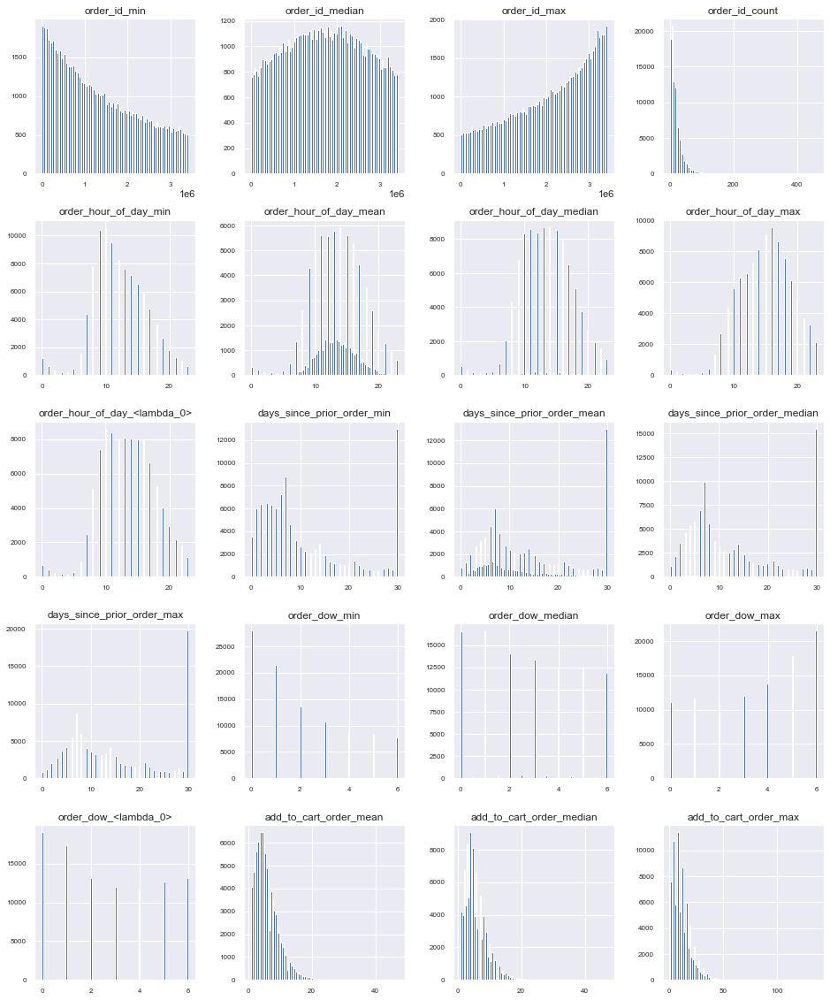

In [26]:
#Plot the distributions of each feature to check whther to split by categorical or continuous
group_ord.hist(figsize=(16, 20), bins=100, xlabelsize=8, ylabelsize=8)

In [27]:
#rename columns for clearer readibility
group_ord = group_ord.rename(columns = {'order_hour_of_day_<lambda_0>' : 'order_hour_of_day_mode', 'order_dow_<lambda_0>': 'order_dow_mode' , 'department_id_<lambda_0>': 'department_id_mode', 'product_id_<lambda_0>':'product_id_mode'})

In [28]:
#separate by metric features and non-metric features

group_ord.columns

Index(['order_id_min', 'order_id_median', 'order_id_max', 'order_id_count',
       'order_hour_of_day_min', 'order_hour_of_day_mean',
       'order_hour_of_day_median', 'order_hour_of_day_max',
       'order_hour_of_day_mode', 'days_since_prior_order_min',
       'days_since_prior_order_mean', 'days_since_prior_order_median',
       'days_since_prior_order_max', 'order_dow_min', 'order_dow_median',
       'order_dow_max', 'order_dow_mode', 'add_to_cart_order_mean',
       'add_to_cart_order_median', 'add_to_cart_order_max'],
      dtype='object')

In [29]:
# Define metric features
metric_features = group_ord[['order_id_min', 'order_id_median', 'order_id_max', 'order_id_count',\
       'order_hour_of_day_min', 'order_hour_of_day_mean',\
       'order_hour_of_day_median', 'order_hour_of_day_max',\
       'order_hour_of_day_mode', 'days_since_prior_order_min',\
       'days_since_prior_order_mean', 'days_since_prior_order_median',\
       'days_since_prior_order_max', 'order_dow_min', 'order_dow_median',\
       'order_dow_max', 'order_dow_mode', 'add_to_cart_order_mean',\
       'add_to_cart_order_median', 'add_to_cart_order_max']]

#Save all percentual features
#categorical = ['department_id_mode', 'order_dow_max', 'order_dow_median', 'order_dow_min', 'order_dow_mode', 'product_id_mode', 

#### 2.1.1 Local Outlier Factor (LOF)

In [30]:
lof = LocalOutlierFactor(n_neighbors=20)
lof_labels = lof.fit_predict(metric_features)
Counter(lof_labels)

#values marked with -1 are outliers

Counter({1: 97695, -1: 1223})

In [31]:
lof_outliers = group_ord[lof_labels==-1]
df_outliers = group_ord.loc[lof_outliers.index.to_list(),:]
df_outliers = df_outliers.reset_index()
df_outliers

,user_id,order_id_min,order_id_median,order_id_max,order_id_count,order_hour_of_day_min,order_hour_of_day_mean,order_hour_of_day_median,order_hour_of_day_max,order_hour_of_day_mode,...,days_since_prior_order_mean,days_since_prior_order_median,days_since_prior_order_max,order_dow_min,order_dow_median,order_dow_max,order_dow_mode,add_to_cart_order_mean,add_to_cart_order_median,add_to_cart_order_max
0,435,2535701,2535701.0,2581538,17,19,19.647059,20.0,20,20,...,8.000000,8.0,8.0,1,1.0,2,1,5.117647,5.0,11
1,609,1706898,1733574.0,1733574,9,10,12.666667,10.0,16,10,...,19.222222,21.0,21.0,0,0.0,6,0,2.777778,3.0,5
2,641,2247633,2255111.0,2255111,23,10,14.173913,18.0,18,18,...,5.521739,6.0,6.0,6,6.0,6,6,6.260870,6.0,12
3,879,1006131,1067972.0,1067972,10,11,13.400000,15.0,15,15,...,5.400000,5.0,6.0,1,1.0,5,1,3.100000,3.0,6
4,1088,2253075,2309840.0,2309840,25,13,13.600000,13.0,16,13,...,11.800000,13.0,13.0,2,2.0,2,2,9.000000,8.0,20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1218,205341,789103,804129.0,804129,18,13,17.888889,21.0,21,21,...,4.333333,2.0,8.0,1,4.0,4,4,5.222222,5.0,11
1219,205385,1083451,1083451.0,1096626,31,11,12.096774,13.0,13,13,...,18.483871,9.0,30.0,0,0.0,3,0,8.322581,8.0,17
1220,205981,2044908,2050848.0,2050848,10,10,14.200000,16.0,16,16,...,6.600000,9.0,9.0,2,2.0,3,2,3.400000,3.0,7
1221,206038,36379,36379.0,47152,32,8,11.718750,15.0,15,15,...,18.750000,30.0,30.0,0,0.0,5,0,8.531250,8.5,17


#### 2.1.2 DBSCAN

In [32]:
#DBSCAN TAKING TOO MUCH TIME TO RUN - 
#Leaving all to behave as outliers

model = DBSCAN(eps = 500, min_samples = 3).fit(metric_features)
db_outliers = metric_features[model.labels_ == -1]
db_outliers.reset_index(inplace = True) 
db_outliers

,user_id,order_id_min,order_id_median,order_id_max,order_id_count,order_hour_of_day_min,order_hour_of_day_mean,order_hour_of_day_median,order_hour_of_day_max,order_hour_of_day_mode,...,days_since_prior_order_mean,days_since_prior_order_median,days_since_prior_order_max,order_dow_min,order_dow_median,order_dow_max,order_dow_mode,add_to_cart_order_mean,add_to_cart_order_median,add_to_cart_order_max
0,2,1501582,1501582.0,1901567,11,10,10.000000,10.0,10,10,...,6.818182,10.0,10.0,1,5.0,5,5,3.272727,3.0,6
1,3,444309,521107.0,2037211,19,18,18.473684,18.0,19,18,...,12.421053,11.0,20.0,0,2.0,3,3,3.947368,4.0,9
2,7,121053,121053.0,121053,24,18,18.000000,18.0,18,18,...,30.000000,30.0,30.0,0,0.0,0,0,12.500000,12.5,24
3,10,83395,83395.0,83395,30,15,15.000000,15.0,15,15,...,14.000000,14.0,14.0,3,3.0,3,3,15.500000,15.5,30
4,11,2921164,2921164.0,2921164,11,11,11.000000,11.0,11,11,...,30.000000,30.0,30.0,5,5.0,5,5,6.000000,6.0,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
98232,206204,2511735,2511735.0,2511735,20,8,8.000000,8.0,8,8,...,11.000000,11.0,11.0,5,5.0,5,5,10.500000,10.5,20
98233,206205,414137,414137.0,414137,7,16,16.000000,16.0,16,16,...,10.000000,10.0,10.0,5,5.0,5,5,4.000000,4.0,7
98234,206206,381242,648225.0,2147399,15,16,17.933333,18.0,19,18,...,2.666667,4.0,4.0,0,3.0,4,0,3.133333,3.0,7
98235,206208,442304,442304.0,1285346,26,11,13.076923,14.0,14,14,...,9.153846,11.0,11.0,1,2.0,2,2,7.961538,7.0,18


In [33]:
#merge both outliers dataframes to get all the instances repeated in both
outliers = pd.merge(df_outliers, db_outliers, how = 'inner', on = 'user_id').set_index('user_id', drop = True)
outliers

,order_id_min_x,order_id_median_x,order_id_max_x,order_id_count_x,order_hour_of_day_min_x,order_hour_of_day_mean_x,order_hour_of_day_median_x,order_hour_of_day_max_x,order_hour_of_day_mode_x,days_since_prior_order_min_x,...,days_since_prior_order_mean_y,days_since_prior_order_median_y,days_since_prior_order_max_y,order_dow_min_y,order_dow_median_y,order_dow_max_y,order_dow_mode_y,add_to_cart_order_mean_y,add_to_cart_order_median_y,add_to_cart_order_max_y
user_id,,,,,,,,,,,,,,,,,,,,,
435,2535701,2535701.0,2581538,17,19,19.647059,20.0,20,20,8.0,...,8.000000,8.0,8.0,1,1.0,2,1,5.117647,5.0,11
609,1706898,1733574.0,1733574,9,10,12.666667,10.0,16,10,17.0,...,19.222222,21.0,21.0,0,0.0,6,0,2.777778,3.0,5
641,2247633,2255111.0,2255111,23,10,14.173913,18.0,18,18,5.0,...,5.521739,6.0,6.0,6,6.0,6,6,6.260870,6.0,12
879,1006131,1067972.0,1067972,10,11,13.400000,15.0,15,15,5.0,...,5.400000,5.0,6.0,1,1.0,5,1,3.100000,3.0,6
1088,2253075,2309840.0,2309840,25,13,13.600000,13.0,16,13,7.0,...,11.800000,13.0,13.0,2,2.0,2,2,9.000000,8.0,20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
205341,789103,804129.0,804129,18,13,17.888889,21.0,21,21,2.0,...,4.333333,2.0,8.0,1,4.0,4,4,5.222222,5.0,11
205385,1083451,1083451.0,1096626,31,11,12.096774,13.0,13,13,9.0,...,18.483871,9.0,30.0,0,0.0,3,0,8.322581,8.0,17
205981,2044908,2050848.0,2050848,10,10,14.200000,16.0,16,16,1.0,...,6.600000,9.0,9.0,2,2.0,3,2,3.400000,3.0,7


In [34]:
#removal of outliers from the working dataframe
key = list(outliers.index.values)

#key = list(df_outliers.index.values)

metric_features = metric_features.drop(index = key)
metric_features

,order_id_min,order_id_median,order_id_max,order_id_count,order_hour_of_day_min,order_hour_of_day_mean,order_hour_of_day_median,order_hour_of_day_max,order_hour_of_day_mode,days_since_prior_order_min,days_since_prior_order_mean,days_since_prior_order_median,days_since_prior_order_max,order_dow_min,order_dow_median,order_dow_max,order_dow_mode,add_to_cart_order_mean,add_to_cart_order_median,add_to_cart_order_max
user_id,,,,,,,,,,,,,,,,,,,,
2,1501582,1501582.0,1901567,11,10,10.000000,10.0,10,10,3.0,6.818182,10.0,10.0,1,5.0,5,5,3.272727,3.0,6
3,444309,521107.0,2037211,19,18,18.473684,18.0,19,18,9.0,12.421053,11.0,20.0,0,2.0,3,3,3.947368,4.0,9
7,121053,121053.0,121053,24,18,18.000000,18.0,18,18,30.0,30.000000,30.0,30.0,0,0.0,0,0,12.500000,12.5,24
10,83395,83395.0,83395,30,15,15.000000,15.0,15,15,14.0,14.000000,14.0,14.0,3,3.0,3,3,15.500000,15.5,30
11,2921164,2921164.0,2921164,11,11,11.000000,11.0,11,11,30.0,30.000000,30.0,30.0,5,5.0,5,5,6.000000,6.0,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
206204,2511735,2511735.0,2511735,20,8,8.000000,8.0,8,8,11.0,11.000000,11.0,11.0,5,5.0,5,5,10.500000,10.5,20
206205,414137,414137.0,414137,7,16,16.000000,16.0,16,16,10.0,10.000000,10.0,10.0,5,5.0,5,5,4.000000,4.0,7
206206,381242,648225.0,2147399,15,16,17.933333,18.0,19,18,0.0,2.666667,4.0,4.0,0,3.0,4,0,3.133333,3.0,7


The outlier removel techniques encountered 1223 outliers.

#### 2.1.3 Applying log to some distributions

In [35]:
#metric_features['order_id_min'], metric_features['order_id_max'] = np.log2(metric_features['order_id_min']), np.log2(metric_features['order_id_max'])
#metric_features['order_id_count'], metric_features['order_dow_min'] = np.log2(metric_features['order_id_count']), np.log2(metric_features['order_dow_min'])

# 2.2 Normalization

Considering the characteristics of the data presented, the normalization techniques will be performed on all metric features, except the one representing percentages. MinMax Scaler will be used to transform data into a scale between 0 and 1, like the percentage features.
In modeling phase a GMM algorithm will be used, in that testing scenario the scaler to be used is Quantile Transformer because data needs to have the best aproximation to a normal distribution


In [36]:
metric_features[metric_features.columns] = scaler.fit_transform(metric_features)
metric_features

,order_id_min,order_id_median,order_id_max,order_id_count,order_hour_of_day_min,order_hour_of_day_mean,order_hour_of_day_median,order_hour_of_day_max,order_hour_of_day_mode,days_since_prior_order_min,days_since_prior_order_mean,days_since_prior_order_median,days_since_prior_order_max,order_dow_min,order_dow_median,order_dow_max,order_dow_mode,add_to_cart_order_mean,add_to_cart_order_median,add_to_cart_order_max
user_id,,,,,,,,,,,,,,,,,,,,
2,0.266338,-0.172478,-0.271302,-0.203379,-0.439001,-0.961429,-0.839121,-1.125776,-0.761353,-0.860725,-0.531833,0.050204,-0.225202,-0.278302,0.901416,0.503497,0.851675,-0.645631,-0.702315,-0.630254
3,-0.752505,-1.121621,-0.172161,0.365531,1.315958,1.331178,1.090995,0.943656,1.040090,0.191865,0.206818,0.127052,0.465405,-5.199338,-0.225202,-0.247134,0.151121,-0.413490,-0.304482,-0.148584
7,-1.494718,-1.906295,-2.083829,0.618059,1.315958,1.199766,1.090995,0.700711,1.040090,5.199338,5.199338,5.199338,5.199338,-5.199338,-5.199338,-5.199338,-5.199338,1.575613,1.649237,1.355761
10,-1.676881,-2.070509,-2.229333,0.860725,0.662724,0.415634,0.366873,-0.022584,0.349483,0.533636,0.338834,0.354822,0.120731,0.497809,0.137177,-0.247134,0.151121,2.023292,2.085356,1.798663
11,1.397347,1.154749,0.667330,-0.203379,-0.171458,-0.659602,-0.558392,-0.877196,-0.497809,5.199338,5.199338,5.199338,5.199338,1.164444,0.901416,0.503497,0.851675,0.258792,0.328223,0.119468
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
206204,1.009410,0.700625,0.216977,0.419741,-1.116369,-1.625274,-1.501861,-1.721914,-1.411293,0.333524,0.084155,0.127052,-0.137177,1.164444,0.901416,0.503497,0.851675,1.231280,1.301191,1.033647
206205,-0.801345,-1.269460,-1.498841,-0.645631,0.875354,0.676854,0.607463,0.214920,0.574595,0.267884,-0.008782,0.050204,-0.225202,1.164444,0.901416,0.503497,0.851675,-0.358833,-0.304482,-0.454249
206206,-0.853002,-0.971663,-0.086002,0.114415,0.875354,1.115247,1.090995,0.943656,1.040090,-5.199338,-1.562721,-1.048748,-1.349498,-5.199338,0.137177,0.081638,-5.199338,-0.665080,-0.702315,-0.454249


# 2.3 Division of data into categories

In order to have more meaningful insights, the features will be divided into categories according to their characteristics. 

In [37]:
metric_features.columns

Index(['order_id_min', 'order_id_median', 'order_id_max', 'order_id_count',
       'order_hour_of_day_min', 'order_hour_of_day_mean',
       'order_hour_of_day_median', 'order_hour_of_day_max',
       'order_hour_of_day_mode', 'days_since_prior_order_min',
       'days_since_prior_order_mean', 'days_since_prior_order_median',
       'days_since_prior_order_max', 'order_dow_min', 'order_dow_median',
       'order_dow_max', 'order_dow_mode', 'add_to_cart_order_mean',
       'add_to_cart_order_median', 'add_to_cart_order_max'],
      dtype='object')

In [38]:
#3 perspectives: 
#a. number of purchases made and how long customer has been with us, 
#b. know how does he buy and when (time of day and day of week, how long are purchases
#c. product interactions (for a given customer, how disperse are the purchases (count) and what are the most common)   

#Customer engagement
customer_fidelity = ['order_id_min', 'order_id_median', 'order_id_max', 'order_id_count',
                    'days_since_prior_order_min', 'days_since_prior_order_mean', 
                     'days_since_prior_order_median','days_since_prior_order_max']
 
#when to buy analysis
when_to_buy = ['order_hour_of_day_min', 'order_hour_of_day_mean',
               'order_hour_of_day_median', 'order_hour_of_day_max',
               'order_hour_of_day_mode', 'order_dow_min', 'order_dow_median',
               'order_dow_max', 'order_dow_mode']

#what and how to buy 
what_to_buy = df_pca.columns

In [39]:
complete_df= group_ord.copy()
complete_df[metric_features.columns]= metric_features
complete_df = complete_df.drop(index = key)
complete_df

,order_id_min,order_id_median,order_id_max,order_id_count,order_hour_of_day_min,order_hour_of_day_mean,order_hour_of_day_median,order_hour_of_day_max,order_hour_of_day_mode,days_since_prior_order_min,days_since_prior_order_mean,days_since_prior_order_median,days_since_prior_order_max,order_dow_min,order_dow_median,order_dow_max,order_dow_mode,add_to_cart_order_mean,add_to_cart_order_median,add_to_cart_order_max
user_id,,,,,,,,,,,,,,,,,,,,
2,0.266338,-0.172478,-0.271302,-0.203379,-0.439001,-0.961429,-0.839121,-1.125776,-0.761353,-0.860725,-0.531833,0.050204,-0.225202,-0.278302,0.901416,0.503497,0.851675,-0.645631,-0.702315,-0.630254
3,-0.752505,-1.121621,-0.172161,0.365531,1.315958,1.331178,1.090995,0.943656,1.040090,0.191865,0.206818,0.127052,0.465405,-5.199338,-0.225202,-0.247134,0.151121,-0.413490,-0.304482,-0.148584
7,-1.494718,-1.906295,-2.083829,0.618059,1.315958,1.199766,1.090995,0.700711,1.040090,5.199338,5.199338,5.199338,5.199338,-5.199338,-5.199338,-5.199338,-5.199338,1.575613,1.649237,1.355761
10,-1.676881,-2.070509,-2.229333,0.860725,0.662724,0.415634,0.366873,-0.022584,0.349483,0.533636,0.338834,0.354822,0.120731,0.497809,0.137177,-0.247134,0.151121,2.023292,2.085356,1.798663
11,1.397347,1.154749,0.667330,-0.203379,-0.171458,-0.659602,-0.558392,-0.877196,-0.497809,5.199338,5.199338,5.199338,5.199338,1.164444,0.901416,0.503497,0.851675,0.258792,0.328223,0.119468
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
206204,1.009410,0.700625,0.216977,0.419741,-1.116369,-1.625274,-1.501861,-1.721914,-1.411293,0.333524,0.084155,0.127052,-0.137177,1.164444,0.901416,0.503497,0.851675,1.231280,1.301191,1.033647
206205,-0.801345,-1.269460,-1.498841,-0.645631,0.875354,0.676854,0.607463,0.214920,0.574595,0.267884,-0.008782,0.050204,-0.225202,1.164444,0.901416,0.503497,0.851675,-0.358833,-0.304482,-0.454249
206206,-0.853002,-0.971663,-0.086002,0.114415,0.875354,1.115247,1.090995,0.943656,1.040090,-5.199338,-1.562721,-1.048748,-1.349498,-5.199338,0.137177,0.081638,-5.199338,-0.665080,-0.702315,-0.454249


In [40]:
complete_df = complete_df.merge(df_pca, left_index = True, right_index = True, how = 'inner')
complete_df

,order_id_min,order_id_median,order_id_max,order_id_count,order_hour_of_day_min,order_hour_of_day_mean,order_hour_of_day_median,order_hour_of_day_max,order_hour_of_day_mode,days_since_prior_order_min,...,order_dow_mode,add_to_cart_order_mean,add_to_cart_order_median,add_to_cart_order_max,PC_0,PC_1,PC_2,PC_3,PC_4,PC_5
user_id,,,,,,,,,,,,,,,,,,,,,
2,0.266338,-0.172478,-0.271302,-0.203379,-0.439001,-0.961429,-0.839121,-1.125776,-0.761353,-0.860725,...,0.851675,-0.645631,-0.702315,-0.630254,-4.672811,4.617433,2.474481,7.025813,-2.526466,-3.786510
3,-0.752505,-1.121621,-0.172161,0.365531,1.315958,1.331178,1.090995,0.943656,1.040090,0.191865,...,0.151121,-0.413490,-0.304482,-0.148584,0.900306,0.232421,-6.539411,-3.239857,6.732297,4.361126
7,-1.494718,-1.906295,-2.083829,0.618059,1.315958,1.199766,1.090995,0.700711,1.040090,5.199338,...,-5.199338,1.575613,1.649237,1.355761,15.431280,2.915303,-3.627399,-0.027953,-1.473887,-0.880194
10,-1.676881,-2.070509,-2.229333,0.860725,0.662724,0.415634,0.366873,-0.022584,0.349483,0.533636,...,0.151121,2.023292,2.085356,1.798663,-2.856548,-2.160762,-3.796529,-1.649168,-1.519149,7.332108
11,1.397347,1.154749,0.667330,-0.203379,-0.171458,-0.659602,-0.558392,-0.877196,-0.497809,5.199338,...,0.851675,0.258792,0.328223,0.119468,-2.672930,-3.512852,-1.480707,7.299006,-2.476827,-4.342035
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
206204,1.009410,0.700625,0.216977,0.419741,-1.116369,-1.625274,-1.501861,-1.721914,-1.411293,0.333524,...,0.851675,1.231280,1.301191,1.033647,-2.757802,-3.741729,-1.288651,9.458604,-1.924249,-4.813606
206205,-0.801345,-1.269460,-1.498841,-0.645631,0.875354,0.676854,0.607463,0.214920,0.574595,0.267884,...,0.851675,-0.358833,-0.304482,-0.454249,-2.588974,-3.406647,-1.492863,6.650500,-2.572105,-4.164665
206206,-0.853002,-0.971663,-0.086002,0.114415,0.875354,1.115247,1.090995,0.943656,1.040090,-5.199338,...,-5.199338,-0.665080,-0.702315,-0.454249,6.662565,0.328289,-3.596348,0.026761,-1.568056,2.669623


# 2.4 Correlations

### 2.4.1 Global PairGrid

In [41]:
#hidden ofor faster computation

#perform a very simple pairplot
g = sns.PairGrid(complete_df, height = 10, corner = True)

#frequency histogram on diagonal
g.map_diag(sns.histplot, color = 'grey', stat = 'frequency', kde = True)

#regplot is a scatter with regression line
g.map_offdiag(sns.regplot, fit_reg=True, x_jitter=.1, color = 'salmon',  marker = 'x')

plt.suptitle("Relationship Between Variables")

Text(0.5, 0.98, 'Relationship Between Variables')

Summarize dataset:   0%|          | 0/41 [00:00<?, ?it/s]

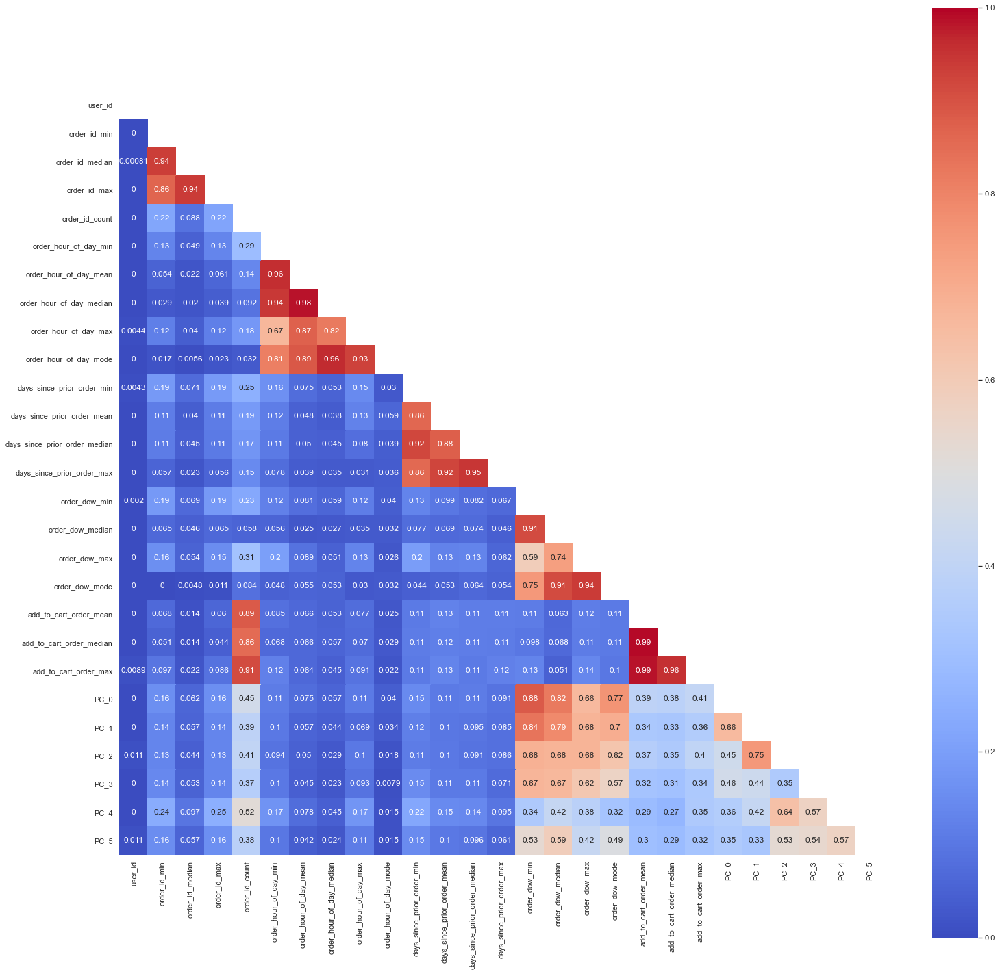

In [42]:
prof = ProfileReport(df=complete_df,explorative=True)
correlations = prof.description_set["correlations"]
corr= correlations["phi_k"]

mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(25,25))
    ax = sns.heatmap(corr, mask=mask, annot = True,cmap='coolwarm',square=True,vmin=0, vmax=1)

### 2.4.3 Category Correlations of Customer Fidelity

#### 2.4.3.1 Spearman Correlation

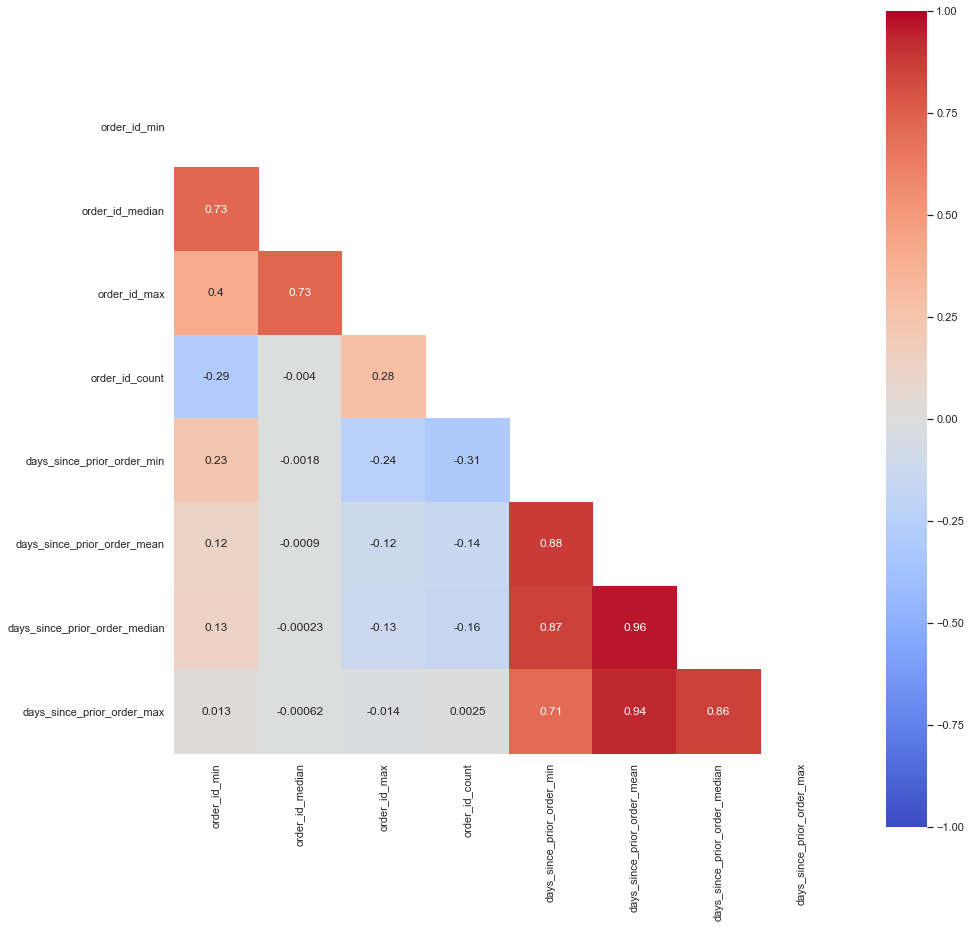

In [43]:
mask = np.zeros_like(complete_df[customer_fidelity].corr("spearman"))
mask[np.triu_indices_from(mask)] = True
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(15,15))
    ax = sns.heatmap(complete_df[customer_fidelity].corr("spearman"),mask=mask, annot = True,cmap='coolwarm',square=True,vmin=-1, vmax=1)

It was decided to keep the following features:

In [44]:
#Variables to keep
fidelity_keep =  ['order_id_count', 'order_id_median', 'order_id_max', 'days_since_prior_order_min']

#### 2.4.3.2 PairGrid

Text(0.5, 0.98, 'Relationship Between Variables')

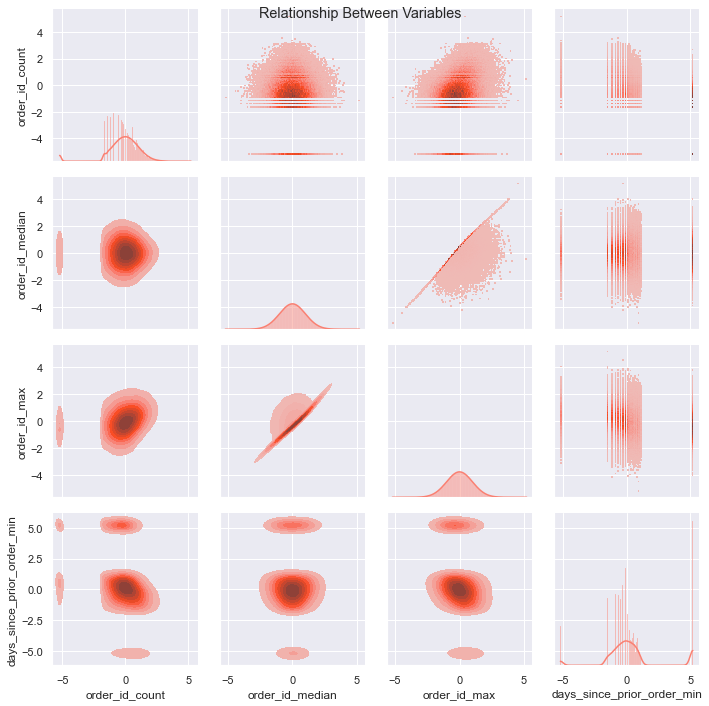

In [45]:
g = sns.PairGrid(complete_df[fidelity_keep])
g.map_upper(sns.histplot, color = 'salmon')
g.map_lower(sns.kdeplot, fill=True, color = 'salmon')
g.map_diag(sns.histplot, kde=True, color = 'salmon')
plt.suptitle("Relationship Between Variables")

### 2.4.4 Category Correlation of Habits
#### 2.4.4.1 Spearman Correlation

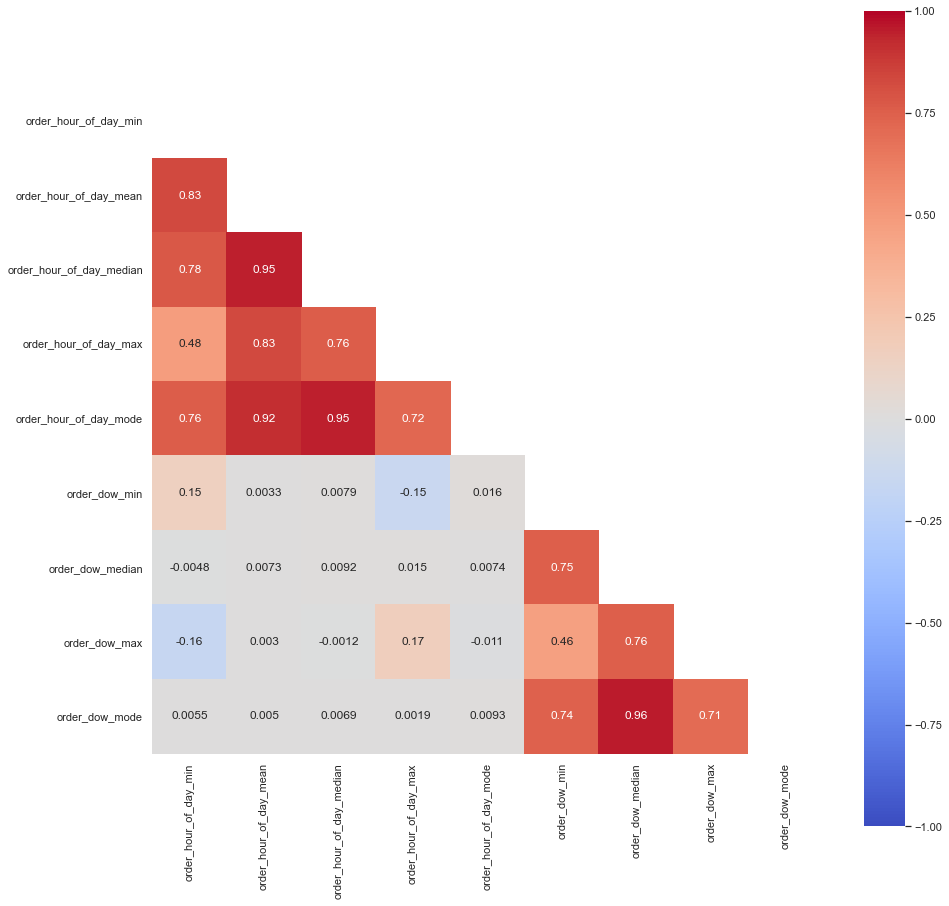

In [46]:
#Correlations in terms of socio-economical variables
mask = np.zeros_like(complete_df[when_to_buy].corr("spearman"))
mask[np.triu_indices_from(mask)] = True
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(15,15))
    ax = sns.heatmap(complete_df[when_to_buy].corr("spearman"),mask=mask, annot = True,cmap='coolwarm',square=True,vmin=-1, vmax=1)

Kept Variables: 

In [47]:
#Variables to keep
whentb_final = ['order_hour_of_day_min', 'order_hour_of_day_mode', 'order_hour_of_day_max', 'order_dow_mode', 'order_dow_min', 'order_dow_max']

#### 2.4.3.2 PairGrid

Text(0.5, 0.98, 'Relationship Between Variables')

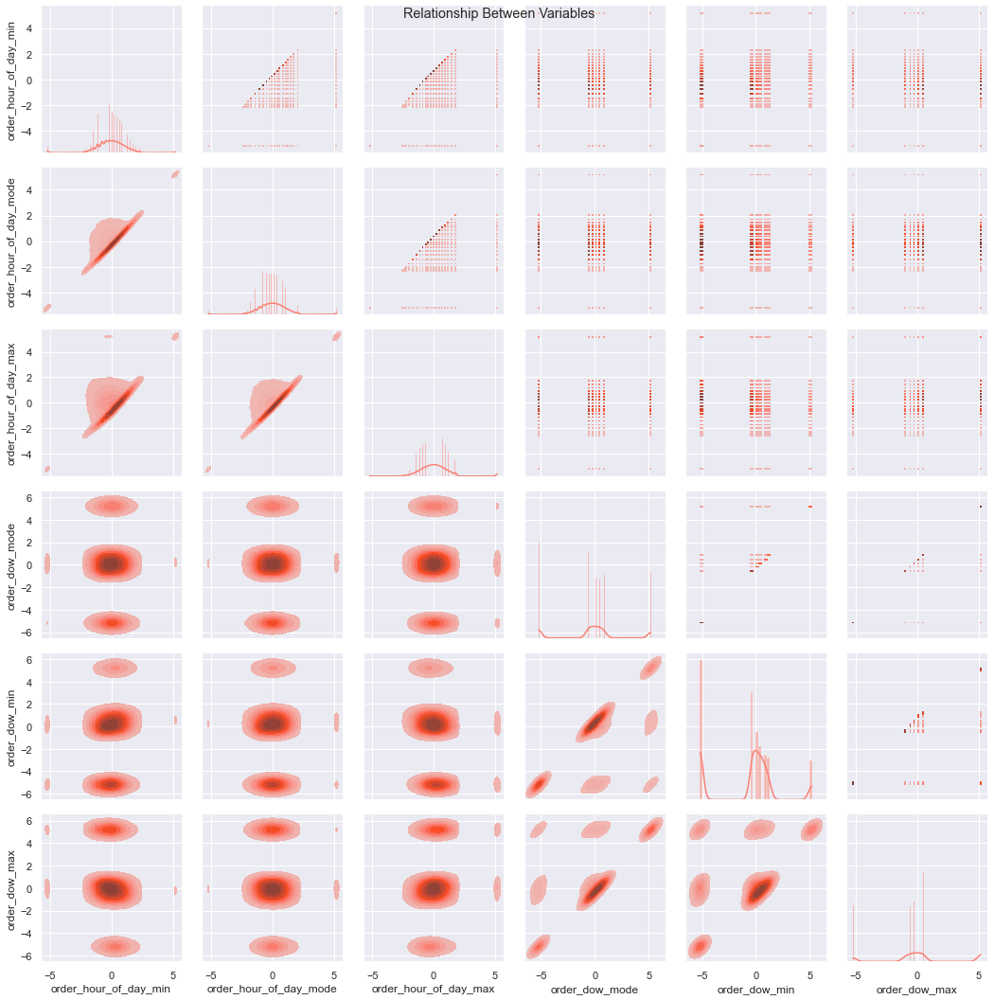

In [48]:
g = sns.PairGrid(complete_df[whentb_final])
g.map_upper(sns.histplot, color = 'salmon')
g.map_lower(sns.kdeplot, fill=True, color = 'salmon')
g.map_diag(sns.histplot, kde=True, color = 'salmon')
plt.suptitle("Relationship Between Variables")

### 2.4.5 Category Correlation of Product Preferences
#### 2.4.5.1 Spearman Correlation

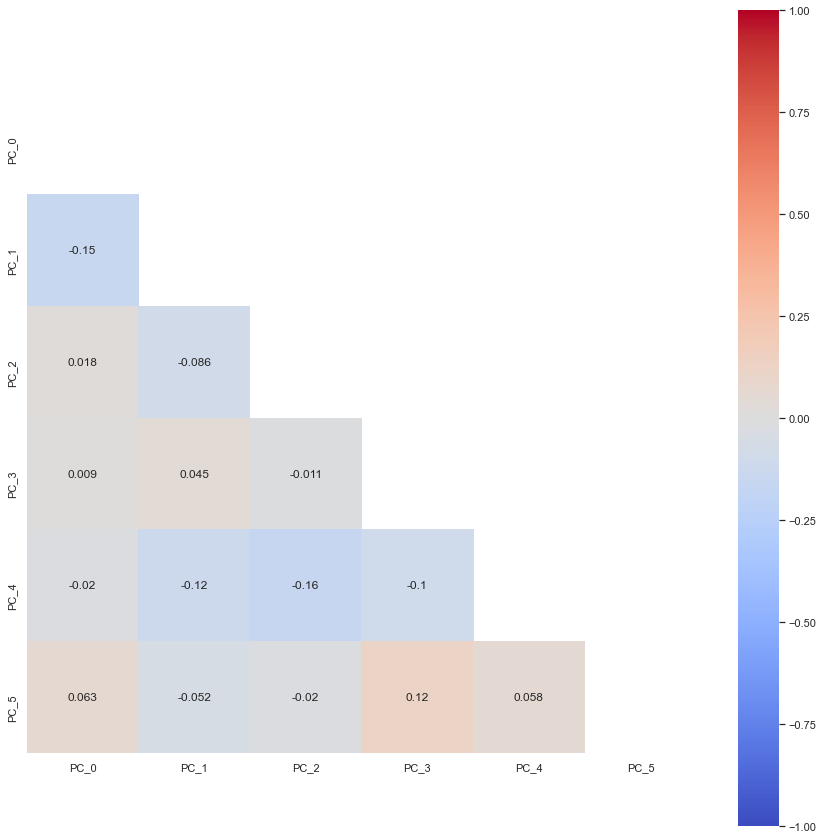

In [49]:
#Correlations in terms of socio-economical variables
mask = np.zeros_like(complete_df[what_to_buy].corr("spearman"))
mask[np.triu_indices_from(mask)] = True
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(15,15))
    ax = sns.heatmap(complete_df[what_to_buy].corr("spearman"),mask=mask, annot = True,cmap='coolwarm',square=True,vmin=-1, vmax=1)

Kept Variables: 

In [50]:
#Variables to keep - based on phik corr index
whattb_final = ['PC_0', 'PC_1', 'PC_2', 'PC_3', 'PC_4', 'PC_5']

#### 2.4.5.2 PairGrid

Text(0.5, 0.98, 'Relationship Between Variables')

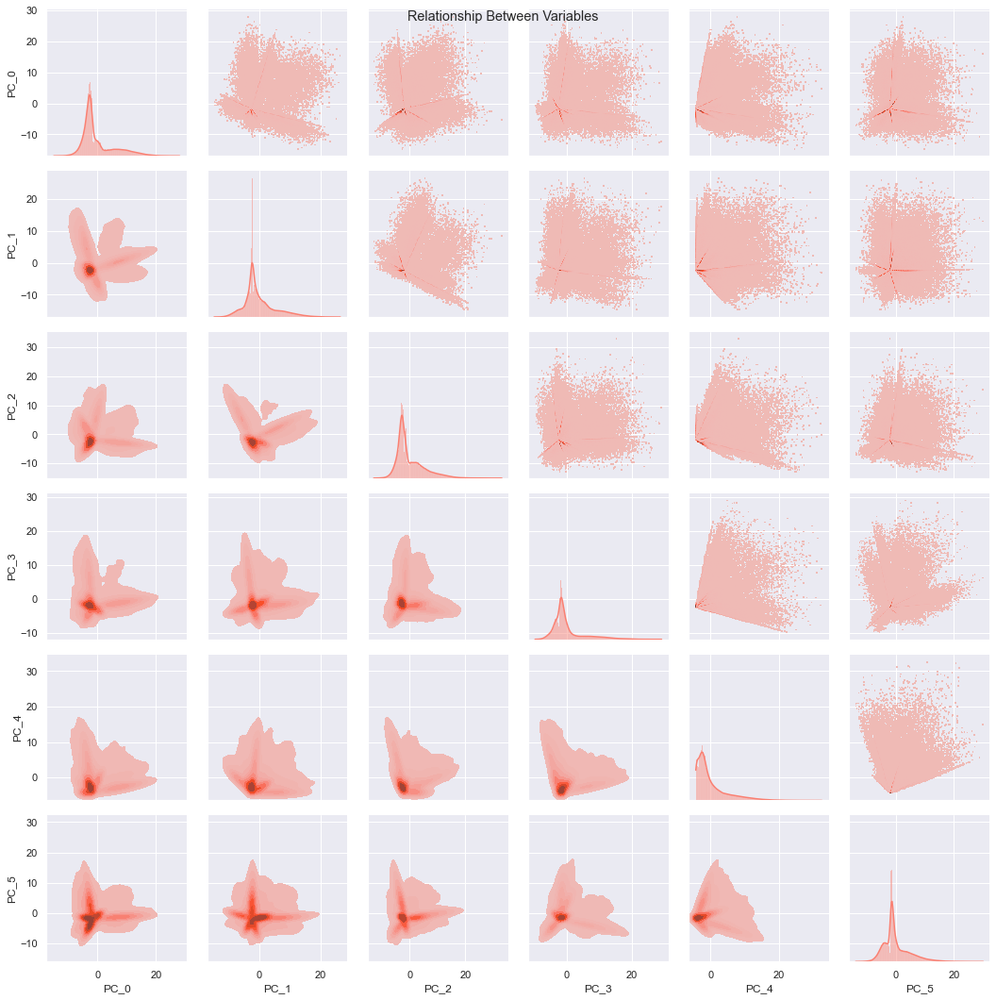

In [51]:
g = sns.PairGrid(complete_df[whattb_final])
g.map_upper(sns.histplot, color = 'salmon')
g.map_lower(sns.kdeplot, fill=True, color = 'salmon')
g.map_diag(sns.histplot, kde=True, color = 'salmon')

plt.suptitle("Relationship Between Variables")

# 3. Secondary Feature Selection

In this step a K-means and ocasionaly a Random Forest will be used in each category to understand which variables are responsible for the highest variance in the cluster, and therefore which variables are the most relevant.

## 3.1 Elbow Plots
The elbow plots will be used to understand what is the optimal K for the K-means algorithms. 

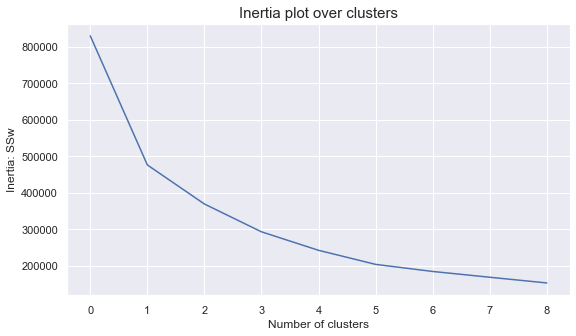

In [52]:
def elbow(df):
    inertia = []
    range_clusters = range(1,10)
    for n_clus in range_clusters:
        kmclust = KMeans(n_clusters=n_clus, init='k-means++', n_init=15, random_state=1)
        kmclust.fit(df)
        inertia.append(kmclust.inertia_) 
        
    plt.figure(figsize=(9,5))
    plt.plot(inertia)
    plt.ylabel("Inertia: SSw")
    plt.xlabel("Number of clusters")
    plt.title("Inertia plot over clusters", size=15)
    plt.show()
    
elbow(complete_df[fidelity_keep])

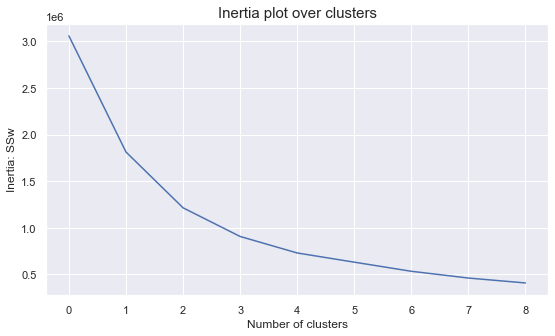

In [53]:
elbow(complete_df[whentb_final])

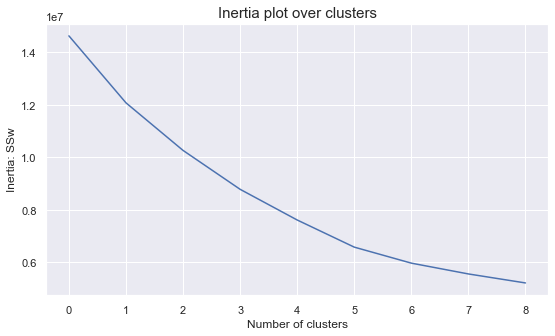

In [54]:
elbow(complete_df[whattb_final])

In [55]:
#K-means Clustering 
def clus_Kmeans(df, nclust):
    model = KMeans(nclust, random_state=0)
    model.fit(df)
    clust_labels = model.predict(df)
    cent = model.cluster_centers_
    return (clust_labels, cent)

def cluster_profiles(df, label_columns, figsize, compar_titles=None):
    if compar_titles == None:
        compar_titles = [""]*len(label_columns)
        
    sns.set()
    fig, axes = plt.subplots(nrows=len(label_columns), ncols=2, figsize=figsize, squeeze=False)
    for ax, label, titl in zip(axes, label_columns, compar_titles):
        # Filtering df
        drop_cols = [i for i in label_columns if i!=label]
        dfax = df.drop(drop_cols, axis=1)
        
        # Getting the cluster centroids and counts
        centroids = dfax.groupby(by=label, as_index=False).mean()
        counts = dfax.groupby(by=label, as_index=False).count().iloc[:,[0,1]]
        counts.columns = [label, "counts"]
        
        # Setting Data
        pd.plotting.parallel_coordinates(centroids, label, color=sns.color_palette(), ax=ax[0])
        sns.barplot(x=label, y="counts", data=counts, ax=ax[1])

        #Setting Layout
        handles, _ = ax[0].get_legend_handles_labels()
        cluster_labels = ["Cluster {}".format(i) for i in range(len(handles))]
        ax[0].annotate(s=titl, xy=(0.95,1.1), xycoords='axes fraction', fontsize=13, fontweight = 'heavy') 
        ax[0].legend(handles, cluster_labels) # Adaptable to number of clusters
        ax[0].axhline(color="black", linestyle="--")
        ax[0].set_title("Cluster Means - {} Clusters".format(len(handles)), fontsize=13)
        ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=-20)
        ax[1].set_xticklabels(cluster_labels)
        ax[1].set_xlabel("")
        ax[1].set_ylabel("Absolute Frequency")
        ax[1].set_title("Cluster Sizes - {} Clusters".format(len(handles)), fontsize=13)
        

    plt.subplots_adjust(hspace=0.4, top=0.90)
    plt.suptitle("Cluster Simple Profilling", fontsize=23)
    plt.show() 
    
def get_ss(df):
    """Computes the sum of squares for all variables given a dataset
    """
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  

def r2(df, labels):
    sst = get_ss(df)
    ssw = np.sum(df.groupby(labels).apply(get_ss))
    return 1 - ssw/sst

def get_ss_variables(df):
    """Get the SS for each variable
    """
    ss_vars = df.var() * (df.count() - 1)
    return ss_vars

def r2_variables(df, labels):
    """Get the R² for each variable
    """
    sst_vars = get_ss_variables(df)
    ssw_vars = np.sum(df.groupby(labels).apply(get_ss_variables))
    return 1 - ssw_vars/sst_vars

# 3.2 Customer Fidelity Feature Selection

### 3.2.1 K-means

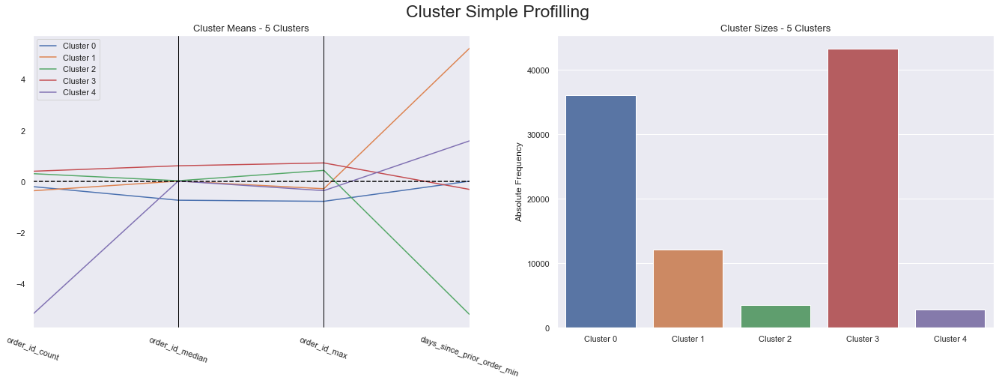

In [56]:
clust_labels, cent = clus_Kmeans(complete_df[fidelity_keep], 5)
kmeans_df = complete_df[fidelity_keep].copy()
kmeans_df["k_labels"] = clust_labels
cluster_profiles(kmeans_df, ["k_labels"], figsize=(23, 7))

In [57]:
r2_variables(kmeans_df, ['k_labels']).drop('k_labels').sort_values()

order_id_median               0.363998
order_id_max                  0.474079
order_id_count                0.540253
days_since_prior_order_min    0.884559
dtype: float64

In [58]:
r2(kmeans_df, ["k_labels"])

0.7644835396926632

### 3.2.2 GMM

In [59]:
#the gmm method was aggregated on a function
from sklearn.mixture import GaussianMixture
def doGMM(df, nclust):
    model=GaussianMixture(n_components=nclust, init_params='kmeans', random_state=0)
    model.fit(df)
    clust_labels = model.predict(df)
    return(clust_labels)

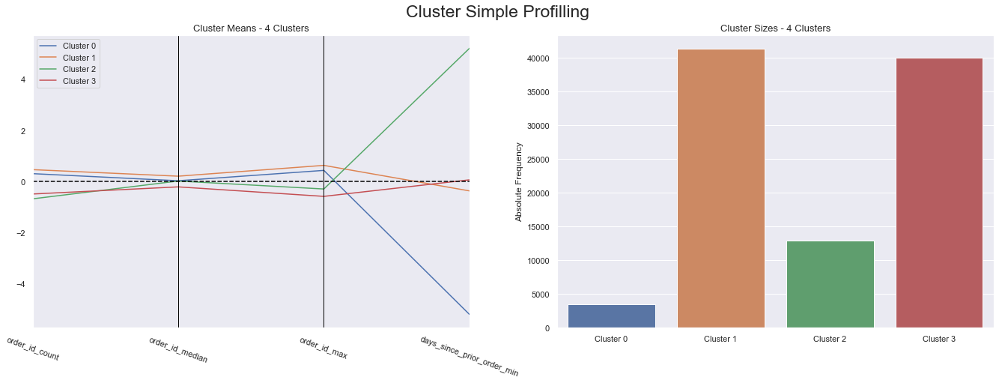

In [60]:
# Comparing both K-means and GMM solutions
clust_labels = doGMM(complete_df[fidelity_keep], 4)
gmm_df = complete_df[fidelity_keep].copy()
gmm_df["gmm_labels"] = clust_labels
cluster_profiles(gmm_df, ["gmm_labels"], figsize=(23, 7))

In [61]:
r2_variables(gmm_df, ['gmm_labels']).drop('gmm_labels').sort_values()

order_id_median               0.036398
order_id_count                0.149496
order_id_max                  0.323919
days_since_prior_order_min    0.918895
dtype: float64

In [62]:
r2(gmm_df, ["gmm_labels"])

0.6372199748570045

### 3.2.3 Random Forest

In [63]:
from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import RandomForestRegressor
def corr_rf(df):
    feature_table = pd.DataFrame(index=df.columns)
    i=0
    for col in df:
        embeded_rf_selector = SelectFromModel(RandomForestRegressor(n_estimators=100), max_features=len(df.columns)-1)
        embeded_rf_selector.fit(df.drop(col,axis=1), df[col])
        embeded_rf_support = embeded_rf_selector.get_support()
        embeded_rf_support = list(embeded_rf_support)
        embeded_rf_support.insert(i,True)
        i+=1

        feature_table[col]=embeded_rf_support
    feature_table['Total'] = np.sum(feature_table, axis=1)
    feature_table = feature_table.sort_values(['Total'] , ascending=False)
    return feature_table

corr_rf(complete_df[fidelity_keep])

,order_id_count,order_id_median,order_id_max,days_since_prior_order_min,Total
order_id_median,True,True,True,True,4
order_id_max,True,True,True,True,4
order_id_count,True,False,False,False,1
days_since_prior_order_min,False,False,False,True,1


## 3.3 When to Buy features Feature Selection

### 3.3.1 K-means

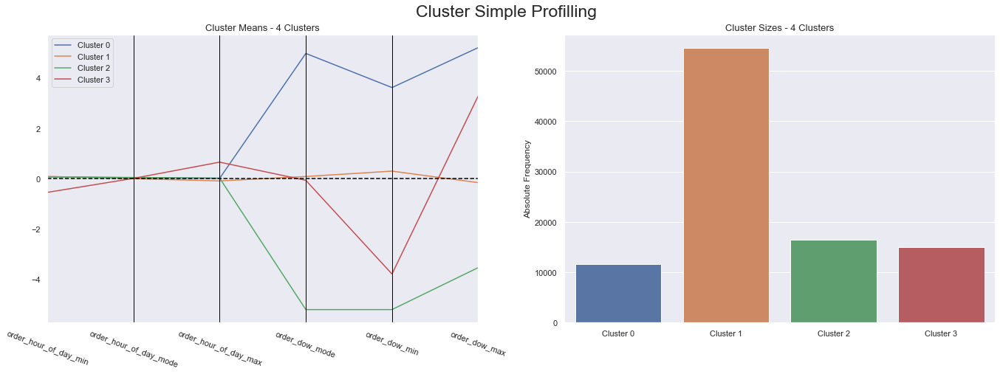

In [64]:
clust_labels, cent = clus_Kmeans(complete_df[whentb_final], 4)
kmeans_df = complete_df[whentb_final].copy()
kmeans_df["k_labels"] = clust_labels
cluster_profiles(kmeans_df, ["k_labels"], figsize=(23, 7))

In [65]:
r2_variables(kmeans_df, ['k_labels']).drop('k_labels').sort_values()

order_hour_of_day_mode    0.000249
order_hour_of_day_min     0.037502
order_hour_of_day_max     0.044850
order_dow_max             0.762927
order_dow_min             0.826319
order_dow_mode            0.836168
dtype: float64

In [66]:
r2(kmeans_df, ["k_labels"])

0.7104641394829592

### 3.3.2 GMM

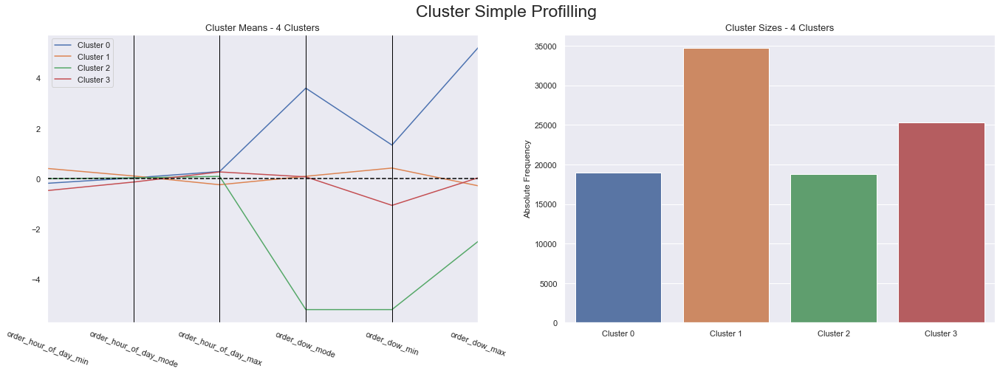

In [67]:
# Comparing both K-means and GMM solutions
clust_labels = doGMM(complete_df[whentb_final], 4)
gmm_df = complete_df[whentb_final].copy()
gmm_df["gmm_labels"] = clust_labels
cluster_profiles(gmm_df, ["gmm_labels"], figsize=(23, 7))

In [68]:
r2_variables(gmm_df, ['gmm_labels']).drop('gmm_labels').sort_values()

order_hour_of_day_mode    0.006548
order_hour_of_day_max     0.035159
order_hour_of_day_min     0.089699
order_dow_min             0.556191
order_dow_max             0.702874
order_dow_mode            0.856252
dtype: float64

In [69]:
r2(gmm_df, ["gmm_labels"])

0.6279751117441468

### 3.3.3 Random Forest

In [70]:
corr_rf(complete_df[whentb_final])

,order_hour_of_day_min,order_hour_of_day_mode,order_hour_of_day_max,order_dow_mode,order_dow_min,order_dow_max,Total
order_hour_of_day_mode,True,True,True,False,False,False,3
order_dow_mode,False,False,False,True,True,True,3
order_hour_of_day_min,True,True,False,False,False,False,2
order_hour_of_day_max,False,True,True,False,False,False,2
order_dow_min,False,False,False,True,True,False,2
order_dow_max,False,False,False,False,False,True,1


## 3.4 What to Buy Interactions Feature Selection
### 3.4.1 K-means

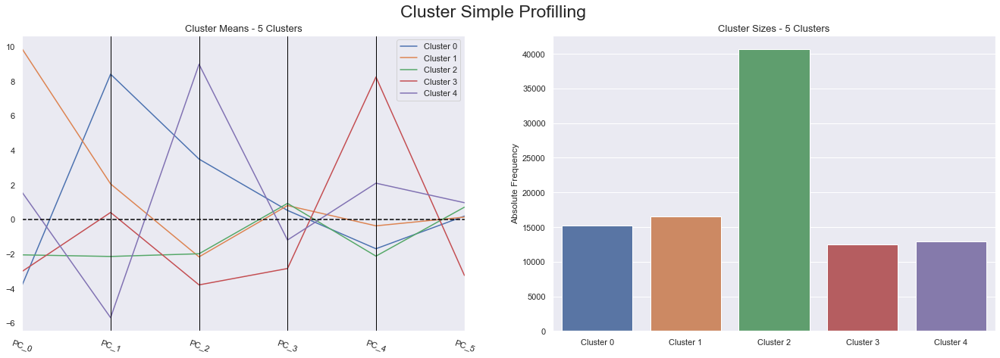

In [71]:
clust_labels, cent = clus_Kmeans(complete_df[whattb_final], 5)
kmeans_df = complete_df[whattb_final].copy()
kmeans_df["k_labels"] = clust_labels
cluster_profiles(kmeans_df, ["k_labels"], figsize=(23, 7))

In [72]:
r2_variables(kmeans_df, ['k_labels']).drop('k_labels').sort_values()

PC_3    0.075416
PC_5    0.079441
PC_4    0.516224
PC_1    0.659929
PC_2    0.684948
PC_0    0.698836
dtype: float64

In [73]:
r2(kmeans_df, ["k_labels"])

0.4841107596453992

### 3.4.2 GMM

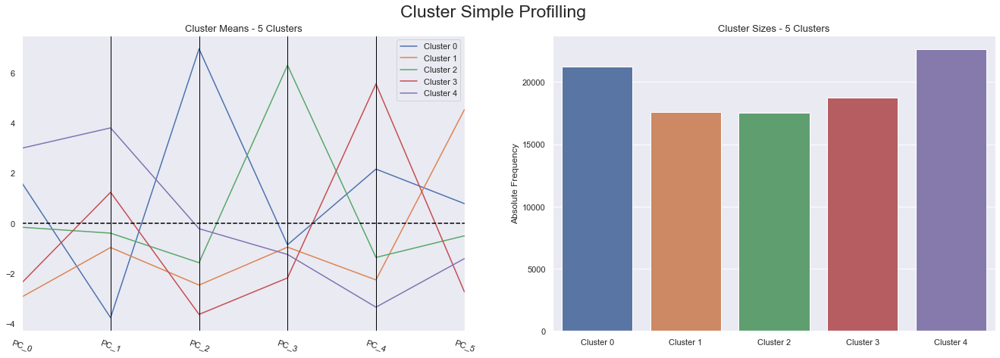

In [74]:
# Comparing both K-means and GMM solutions
clust_labels = doGMM(complete_df[whattb_final], 5)
gmm_df = complete_df[whattb_final].copy()
gmm_df["gmm_labels"] = clust_labels
cluster_profiles(gmm_df, ["gmm_labels"], figsize=(23, 7))

In [75]:
r2_variables(gmm_df, ['gmm_labels']).drop('gmm_labels').sort_values()

PC_0    0.166520
PC_1    0.253348
PC_5    0.271331
PC_3    0.379641
PC_4    0.476571
PC_2    0.591470
dtype: float64

In [76]:
r2(gmm_df, ["gmm_labels"])

0.3553126676650321

### 3.4.3 Random Forest

In [77]:
corr_rf(complete_df[whattb_final])

,PC_0,PC_1,PC_2,PC_3,PC_4,PC_5,Total
PC_2,True,True,True,False,True,True,5
PC_1,True,True,True,True,False,False,4
PC_0,True,True,False,True,False,False,3
PC_3,False,False,False,True,True,True,3
PC_4,False,False,False,False,True,True,2
PC_5,False,False,False,False,False,True,1


After performing all the analysis it was decided to remove the following variables: 'add_to_cart_order_median', 'order_dow_max', 'order_dow_min', 

In [78]:
#join all categories and drop selectecd features
final_df = complete_df[fidelity_keep]
final_df.reset_index(inplace=True)
final_df = final_df.merge(complete_df[whentb_final], on='user_id') 
final_df = final_df.merge(complete_df[whattb_final], on='user_id') 
final_df.set_index('user_id',inplace=True)
final_df.drop(columns= ['order_id_median', 'order_hour_of_day_mode', 'order_hour_of_day_min',
                        'order_hour_of_day_max', 'order_dow_min', 'order_dow_max', 'order_id_max'
#                        'PC_11', 'PC_5', 'PC_10', 'PC_8', 'PC_9', 'PC_1', 'PC_11', 'PC_7', 'PC_6', 
#                        'order_id_max', 'PC_2', 'order_dow_min'
                       ],inplace=True)
final_df

,order_id_count,days_since_prior_order_min,order_dow_mode,PC_0,PC_1,PC_2,PC_3,PC_4,PC_5
user_id,,,,,,,,,
2,-0.203379,-0.860725,0.851675,-4.672811,4.617433,2.474481,7.025813,-2.526466,-3.786510
3,0.365531,0.191865,0.151121,0.900306,0.232421,-6.539411,-3.239857,6.732297,4.361126
7,0.618059,5.199338,-5.199338,15.431280,2.915303,-3.627399,-0.027953,-1.473887,-0.880194
10,0.860725,0.533636,0.151121,-2.856548,-2.160762,-3.796529,-1.649168,-1.519149,7.332108
11,-0.203379,5.199338,0.851675,-2.672930,-3.512852,-1.480707,7.299006,-2.476827,-4.342035
...,...,...,...,...,...,...,...,...,...
206204,0.419741,0.333524,0.851675,-2.757802,-3.741729,-1.288651,9.458604,-1.924249,-4.813606
206205,-0.645631,0.267884,0.851675,-2.588974,-3.406647,-1.492863,6.650500,-2.572105,-4.164665
206206,0.114415,-5.199338,-5.199338,6.662565,0.328289,-3.596348,0.026761,-1.568056,2.669623


# 4. Modeling
Looking for the best r2 score, it will be the one to perform the clustering.
<br>
<br>

### 4.1 Elbow Plot

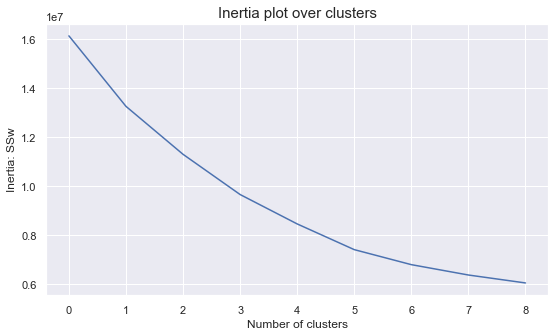

In [79]:
elbow(final_df)

### 4.2Cluster Profiling

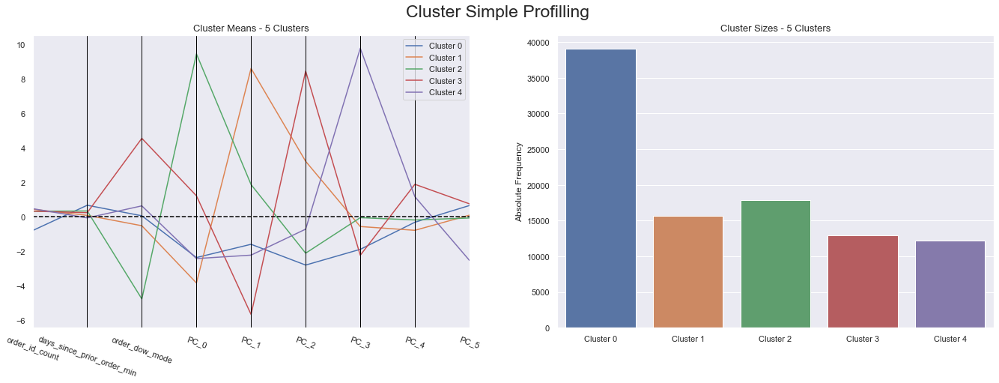

In [80]:
clust_labels, cent = clus_Kmeans(final_df, 5)
kmeans_df = final_df.copy()
kmeans_df["k_labels"] = clust_labels
cluster_profiles(kmeans_df, ["k_labels"], figsize=(23, 7))

In [81]:
r2_variables(kmeans_df, ['k_labels']).drop('k_labels').sort_values()

days_since_prior_order_min    0.015443
PC_4                          0.034310
PC_5                          0.049311
order_id_count                0.205891
PC_3                          0.613304
PC_2                          0.615534
PC_1                          0.675519
PC_0                          0.695815
order_dow_mode                0.777222
dtype: float64

In [82]:
r2(kmeans_df, ["k_labels"])

0.482010229438674

# 5. Cluster Data Exploration
### 5.1 Box-plots of cluster features

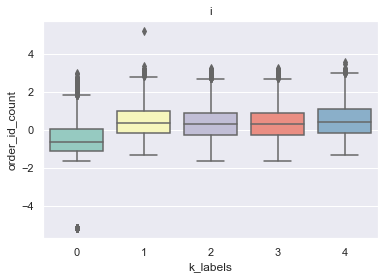

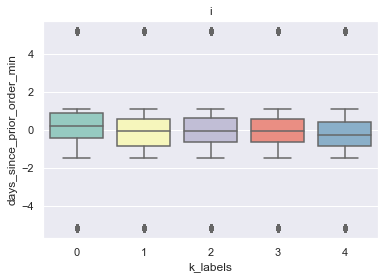

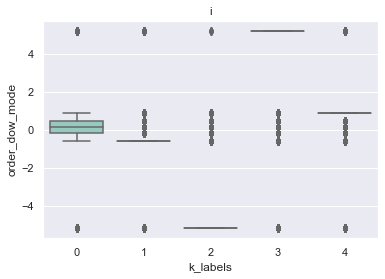

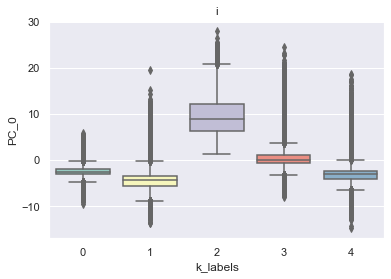

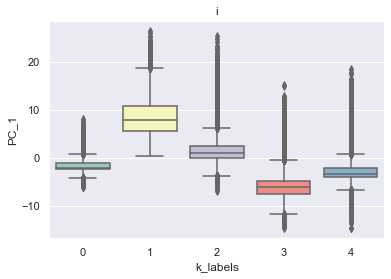

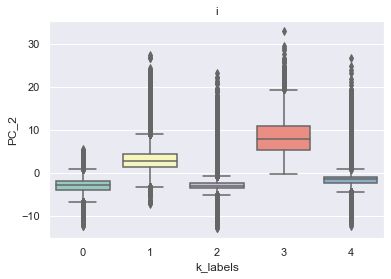

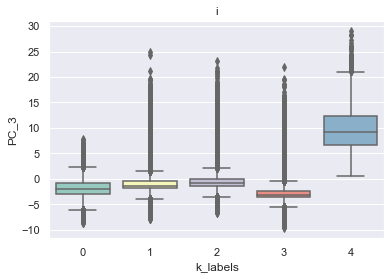

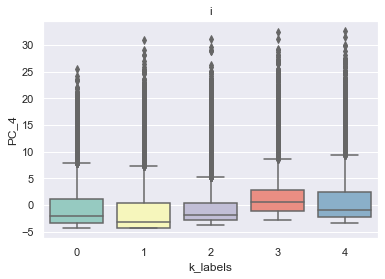

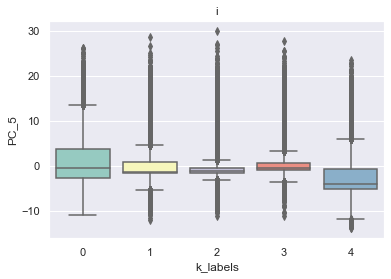

In [83]:
df_plots= kmeans_df.iloc[:,:-1]
fig, axes = figsize=(20, 11)

for i in(df_plots.columns):
    sns.boxplot(x = "k_labels", y = i, data=kmeans_df, palette="Set3")
    plt.title('i')
    plt.show()

In [84]:
kmeans_df

,order_id_count,days_since_prior_order_min,order_dow_mode,PC_0,PC_1,PC_2,PC_3,PC_4,PC_5,k_labels
user_id,,,,,,,,,,
2,-0.203379,-0.860725,0.851675,-4.672811,4.617433,2.474481,7.025813,-2.526466,-3.786510,4
3,0.365531,0.191865,0.151121,0.900306,0.232421,-6.539411,-3.239857,6.732297,4.361126,0
7,0.618059,5.199338,-5.199338,15.431280,2.915303,-3.627399,-0.027953,-1.473887,-0.880194,2
10,0.860725,0.533636,0.151121,-2.856548,-2.160762,-3.796529,-1.649168,-1.519149,7.332108,0
11,-0.203379,5.199338,0.851675,-2.672930,-3.512852,-1.480707,7.299006,-2.476827,-4.342035,4
...,...,...,...,...,...,...,...,...,...,...
206204,0.419741,0.333524,0.851675,-2.757802,-3.741729,-1.288651,9.458604,-1.924249,-4.813606,4
206205,-0.645631,0.267884,0.851675,-2.588974,-3.406647,-1.492863,6.650500,-2.572105,-4.164665,4
206206,0.114415,-5.199338,-5.199338,6.662565,0.328289,-3.596348,0.026761,-1.568056,2.669623,2


### Visualize Clusters with TSNE

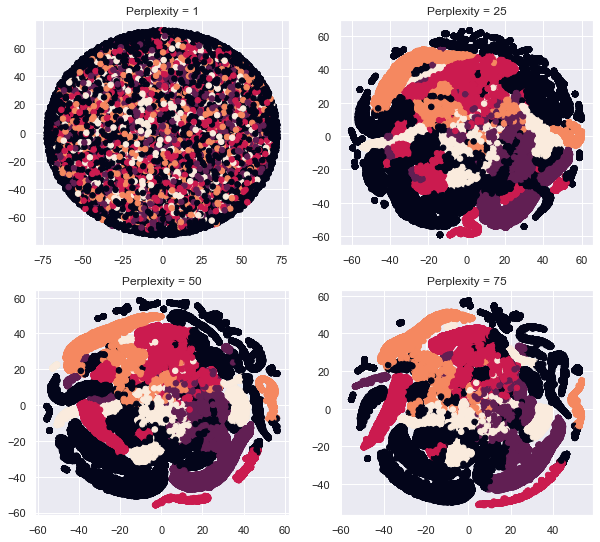

In [85]:
#check different perplexity levels for 2D visualization

plt.figure(figsize = (10,5))
plt.subplots_adjust(top = 1.5)

for index, p in enumerate([1, 25, 50, 75]):

    tsne = TSNE(n_components = 2, perplexity = p, random_state=0)
    tsne_results = tsne.fit_transform(final_df)
    
    tsne_results=pd.DataFrame(tsne_results, columns=['tsne1', 'tsne2'])
    
    plt.subplot(2,2,index+1)
    plt.scatter(tsne_results['tsne1'], tsne_results['tsne2'], c=kmeans_df['k_labels'], s=30)
    plt.title('Perplexity = '+ str(p))
plt.show()

# 6. Get CSV of Clusters

In [86]:
#get back to initial cluster

to_merge = kmeans_df.filter(["k_labels"])
to_merge

,k_labels
user_id,
2,4
3,0
7,2
10,0
11,4
...,...
206204,4
206205,4
206206,2


In [87]:
complete_orders= pd.merge(complete_orders,to_merge, left_on='user_id', right_index=True)
complete_orders

,department_id,department,product_id,product_name,order_id,add_to_cart_order,reordered,user_id,order_number,order_dow,order_hour_of_day,days_since_prior_order,k_labels
0,1,frozen,38,frozen meals,11,1,1,143742,4,Monday,19,23.0,1
1,13,pantry,19,oils vinegars,11,5,1,143742,4,Monday,19,23.0,1
2,15,canned goods,59,canned meals beans,11,3,1,143742,4,Monday,19,23.0,1
3,19,snacks,107,chips pretzels,11,4,1,143742,4,Monday,19,23.0,1
4,20,deli,67,fresh dips tapenades,11,2,1,143742,4,Monday,19,23.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019488,21,missing,100,missing,1296769,1,1,50727,10,Friday,12,15.0,0
2019491,21,missing,100,missing,1648925,1,1,9568,8,Thursday,16,6.0,0
2019492,21,missing,100,missing,1955853,1,1,200270,3,Saturday,23,13.0,0
2019496,21,missing,100,missing,2574710,1,0,205651,6,Tuesday,16,30.0,0


In [88]:
complete_orders.to_csv('./CSV/complete_orders.csv')